# First pipeline using `pytesseract` package

---

To install tesseract on Ubuntu I used : https://www.datacorner.fr/tesseract/

## Import package

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
from dyslexia import preprocessing
from dyslexia.io import load_image
from dyslexia.ocr import extract_text_from_image
from dyslexia.plots import plot_image, plot_2_images

import os
from os.path import join, isdir, isfile
from os import listdir
import time

import cv2
import numpy as np
import matplotlib.pyplot as plt

In [4]:
%env TESSDATA_PREFIX /usr/share/tesseract-ocr/4.00/tessdata/

env: TESSDATA_PREFIX=/usr/share/tesseract-ocr/4.00/tessdata/


## List examples files

In [18]:
# Get all directories with examples
example_path = '../Exemples/'
subdir_paths = [
    join(example_path, p) 
    for p in listdir(example_path) 
    if isdir(join(example_path, p))
]

# Retrieves all files in example dir
all_files = []
for p in [example_path] + subdir_paths:
    _files = [join(p, f) for f in listdir(p) if isfile(join(p, f))]
    
    all_files = all_files + _files
    

# Keeps only jpg extension files
all_files = [f for f in all_files if f[-3:] in ['jpg']]

all_files

['../Exemples/Ex_Maths/IMG_20210329_123828.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122221.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_123818.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122227.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122202.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122715.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122724.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_123813.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122157.jpg',
 '../Exemples/Ex_Maths/IMG_20210329_122738.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122543.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_123005.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122940.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_123000.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122932.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122524.jpg',
 '../Exemples/Histoire_Geo/IMG_20210329_122536.jpg',
 '../Exemples/Dictee/IMG_20210329_122324.jpg',
 '../Exemples/Dictee/IMG_20210329_122825.jpg',
 '../Exemples/Dictee/IMG_20210329_122839.jpg'

In [6]:
subdir_paths

['../Exemples/Ex_Maths',
 '../Exemples/Histoire_Geo',
 '../Exemples/Dictee',
 '../Exemples/SVT',
 '../Exemples/Ex_COD',
 '../Exemples/Present_indicatif']

## Try pytesseract usage

More details on the Pypi page : https://pypi.org/project/pytesseract/

In [19]:
subdir = subdir_paths[3]

print('Directory:', subdir)
results = {}

for fpath in [f for f in all_files if subdir in f]:
    print(fpath)
    res = {}
    t0 = time.time()
    
    img = load_image(fpath)
    
    text = extract_text_from_image(img)
    
    t_end = time.time() - t0
    print('end in %.1fs'%t_end)
    
    res['time'] = t_end
    res['text'] = text
    res['img'] = img
    
    results[fpath] = res
    

Directory: ../Exemples/SVT
../Exemples/SVT/IMG_20210329_123138.jpg
end in 5.3s
../Exemples/SVT/IMG_20210329_122617.jpg
end in 5.1s
../Exemples/SVT/IMG_20210329_122614.jpg
end in 4.9s
../Exemples/SVT/IMG_20210329_123021.jpg
end in 4.3s
../Exemples/SVT/IMG_20210329_122633.jpg
end in 5.3s
../Exemples/SVT/IMG_20210329_122621.jpg
end in 5.2s
../Exemples/SVT/IMG_20210329_122629.jpg
end in 5.4s
../Exemples/SVT/IMG_20210329_123025.jpg
end in 5.1s
../Exemples/SVT/IMG_20210329_123017.jpg
end in 4.1s
../Exemples/SVT/IMG_20210329_123029.jpg
end in 5.2s
../Exemples/SVT/IMG_20210329_123132.jpg
end in 4.8s


In [20]:
for k, res in results.items():
    print(k)
    print()
    print(res['text'])
    print()
    print('==============================')

../Exemples/SVT/IMG_20210329_123138.jpg

ve quoil e€st composee la plante’

La plante est composée:
=—

d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),

- d'une partie en surface (tige, feuilles,graines , fruits,fleurs)

2.  De quoi a besoin la plante?

.

Soleil

Le soleil permet à la plante de récupérer de l'énergie pour se développ
Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.

Oxygène

Tout comme le soleil, l’oxygène est essentiel pour la survie de la plante.

L'eau apporte des nutriments (qui sont essentie
rester en bon état).

La partie souterraine de
place. Si les racine:
croissanc

 


../Exemples/SVT/IMG_20210329_122617.jpg

Les plantes

1.  De quoi est composée la plante?

La plante est composée: -
- d’'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),
- d'une partie en surface (tige, feuilles,graines.ﬁuits,ﬂeuœ)

2.  De quoi a besoin la plante?


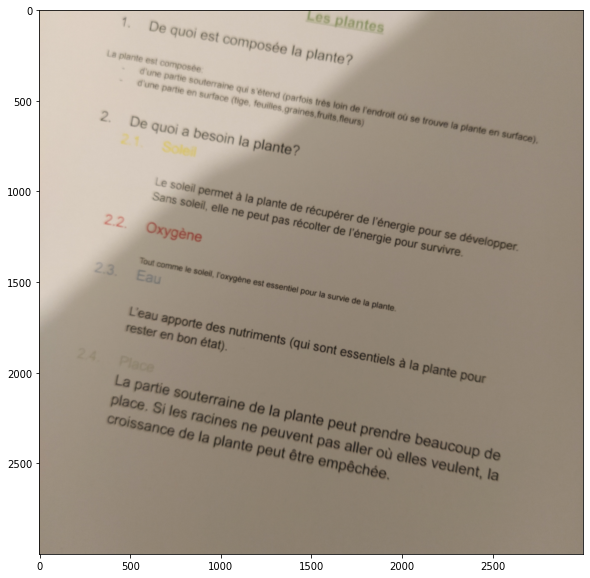

In [25]:
_path = '../Exemples/SVT/IMG_20210329_123017.jpg'
_img = results[_path]['img']
plot_image(_img)

Before doing some preprocessing we need to identify the text angle so we can rotate the image and we need to remove the shadow.

## First preprocessed pipeline

If we want to get better results, we need to put the image with a correct text orientation on the `tesseract` model and also shadows on an picture can be a problem.

So I propose this preprocess pipeline:

1. Load image
2. Remove shadow
3. To grayscale with threshold (black and white)
4. Correction of the text angle
5. Tesseract: extract text from image

In [7]:
def preprocess_image(image):    
    image_no_shadow = preprocessing.remove_shadow(image)
    
    image_gray = preprocessing.image_to_gray(image_no_shadow, threshold=True)

    angle = preprocessing.find_text_angle(image_gray)

    image_fixed = preprocessing.rotate_img(image_gray, angle=angle)
    
    return image_fixed

### Test pipeline

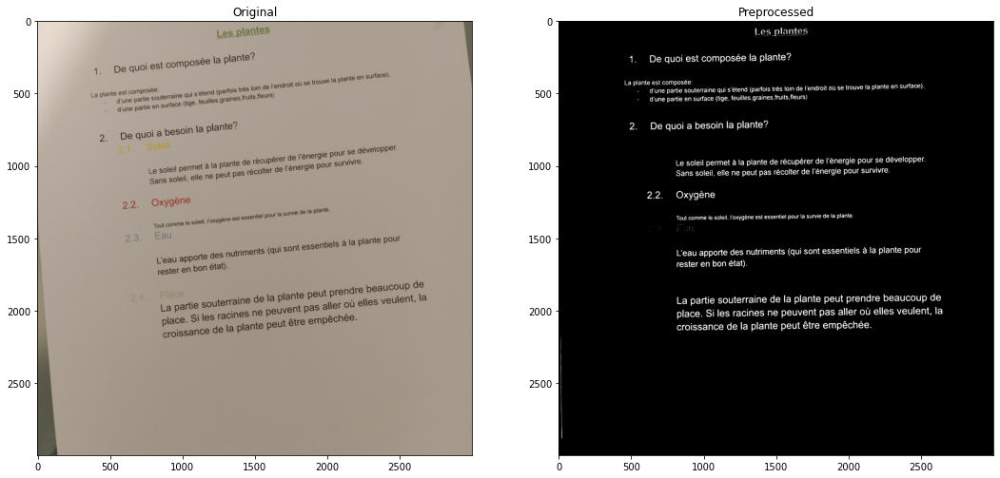

In [8]:
# rotate text
fpath = '../Exemples/SVT/IMG_20210329_123029.jpg'

image_orig = load_image(fpath)
image_prep = preprocess_image(image_orig)

plot_2_images(image_orig, image_prep)

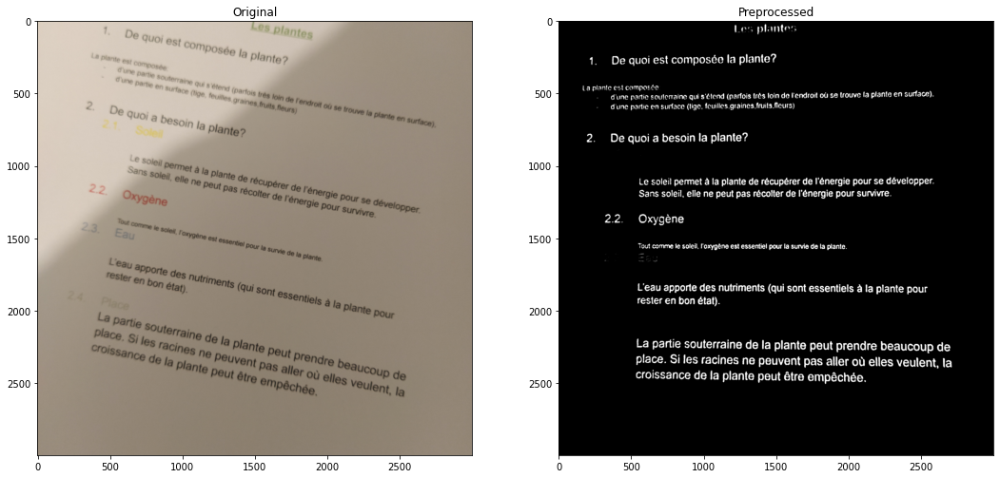

In [9]:
# rotate + shadow
fpath = '../Exemples/SVT/IMG_20210329_123017.jpg'

image_orig = load_image(fpath)
image_prep = preprocess_image(image_orig)

plot_2_images(image_orig, image_prep)

In [105]:
# subdir = subdir_paths[3]
# paths = [f for f in files if subdir in f]#[:3]

# test_img_fn(paths, preprocess_image)

### Try pipeline on many images

In [10]:
from IPython.display import display, HTML
import pandas as pd

def pretty_print(df):
    return display( HTML( df.to_html().replace("\\n","<br>") ) )

In [13]:
def analyse_pipeline(files):
    results = {}

    for fpath in files:
        print(fpath)
        res = {}

        # Compute load time
        t0 = time.time()
        image = load_image(fpath)
        t_load = time.time() - t0

        # Compute preprocess time
        image_preprocessed = preprocess_image(image) 
        t_preprocess = time.time() - t0
        print('time preprocessed: %.3fs'%t_preprocess)

        # Extract text time on original image
        t0 = time.time()
        text_orig = extract_text_from_image(image)
        t_res_origin = time.time() - t0
        print('time extract text from original: %.3fs'%t_res_origin)

        # Extract text time on preprocessed image
        t0 = time.time()
        text_prep = extract_text_from_image(image_preprocessed)
        t_res_preproc = time.time() - t0
        print('time extract text from preprocessed: %.3fs'%t_res_preproc)

        # Plots 2 images
        plot_2_images(image, image_preprocessed)

        # Show results
        df = pd.DataFrame()
        df['Original'] = [text_orig]
        df['Preprocessed'] = [text_prep]

        pretty_print(df)

        res['time_load'] = t_load
        res['time_preprocess'] = t_preprocess
        res['time_res_original'] = t_res_origin
        res['time_res_preprocess'] = t_res_preproc

        res['text_orig'] = text_orig
        res['text_preprocess'] = text_prep

        results[fpath] = res

        print()
        print('=======================================')
        print()
        
    return results

../Exemples/SVT/IMG_20210329_123138.jpg
time preprocessed: 1.213s
time extract text from original: 4.601s
time extract text from preprocessed: 1.585s


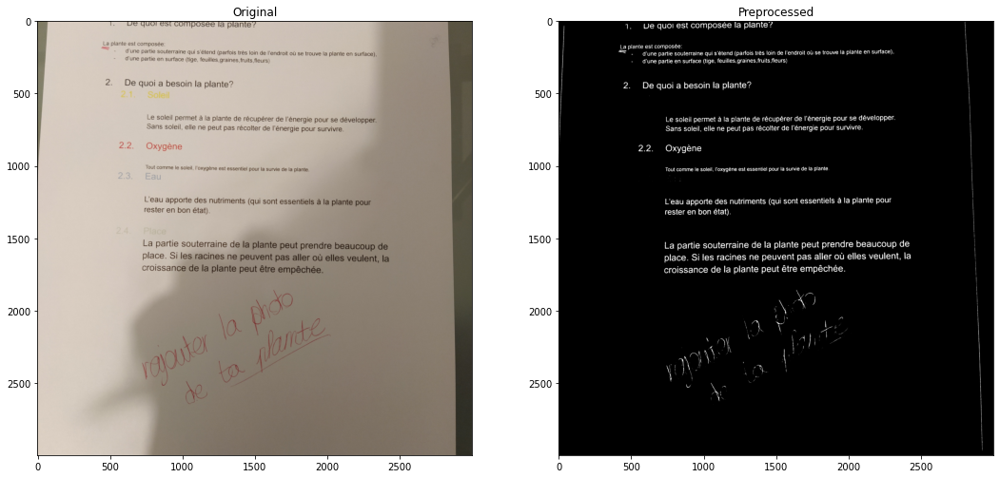

,Original,Preprocessed
0,"ve quoil e€st composee la plante’La plante est composée:=—d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines , fruits,fleurs)2. De quoi a besoin la plante?.SoleilLe soleil permet à la plante de récupérer de l'énergie pour se développSans soleil, elle ne peut pas récolter de l'énergie pour survivre.OxygèneTout comme le soleil, l’oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentierester en bon état).La partie souterraine deplace. Si les racine:croissanc","1. LUe quoi est composée la plante ?La piante est composée:# - _ d'une partie souterraine qui s’étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante”Le soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2.2. OxygèneTout comme le soleil, l’oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.>Le/\.- A ;e p| ñ> . , (R*py\ ﬁ\( e \ A } ; g | 7!——sLV"




../Exemples/SVT/IMG_20210329_122617.jpg
time preprocessed: 1.217s
time extract text from original: 4.982s
time extract text from preprocessed: 1.477s


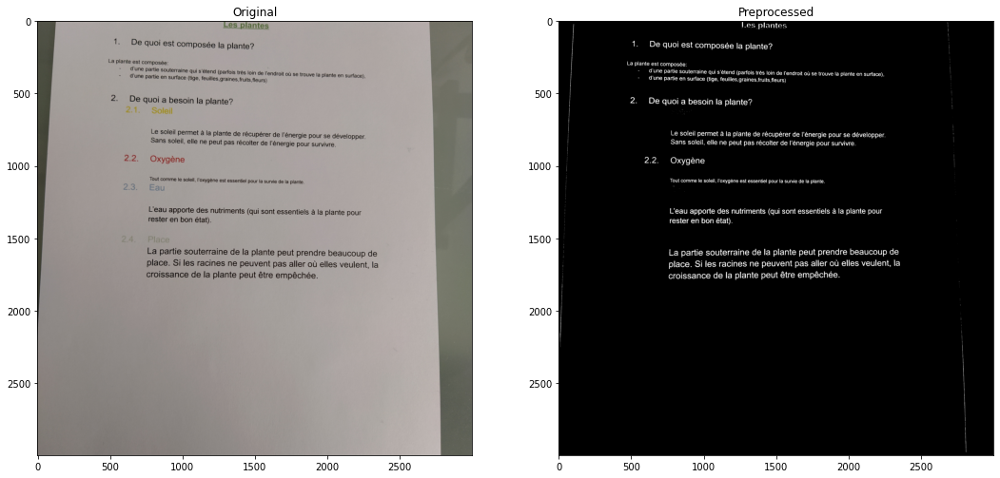

,Original,Preprocessed
0,"Les plantes1. De quoi est composée la plante?La plante est composée: -- d’'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines.ﬁuits,ﬂeuœ)2. De quoi a besoin la plante?’tAeSoleilLe soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).PlaceLa partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","les plantes1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines, fruits,fleurs)2. De quoi a besoin la plante?Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.2.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_122614.jpg
time preprocessed: 1.170s
time extract text from original: 4.637s
time extract text from preprocessed: 1.517s


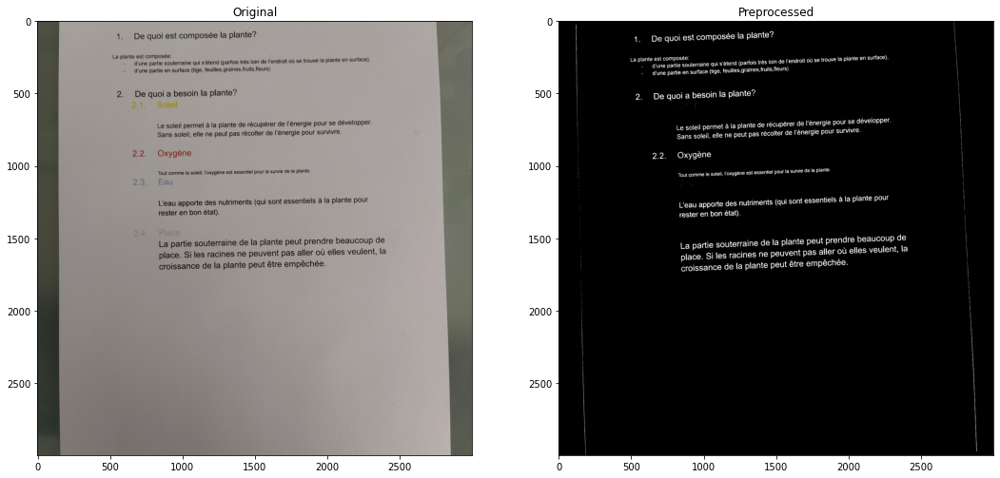

,Original,Preprocessed
0,"1. De quoi est composée la plante?La plante est composée:- _ d’une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- _ d’une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante?dh222.eSoleilLe soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).p3j pnriactLa partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","1. De quoi est composée la plante?La plante est composée:d'une partie souterraine eESXA GU R CEUCAUSS toin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles.graines,fmits,ﬂeura)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123021.jpg
time preprocessed: 1.188s
time extract text from original: 4.209s
time extract text from preprocessed: 1.518s


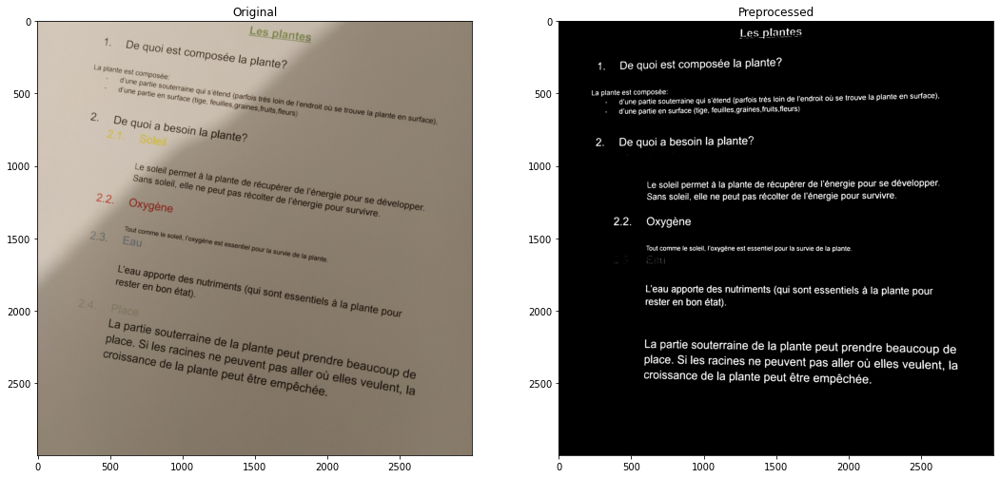

,Original,Preprocessed
0,,"Les plantes1. De quoi est composée la plante?La plante est composée: ,° d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d’une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante”2.2.Le soleil permet à la plante de récupérer de l’_énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_122633.jpg
time preprocessed: 1.130s
time extract text from original: 5.368s
time extract text from preprocessed: 1.319s


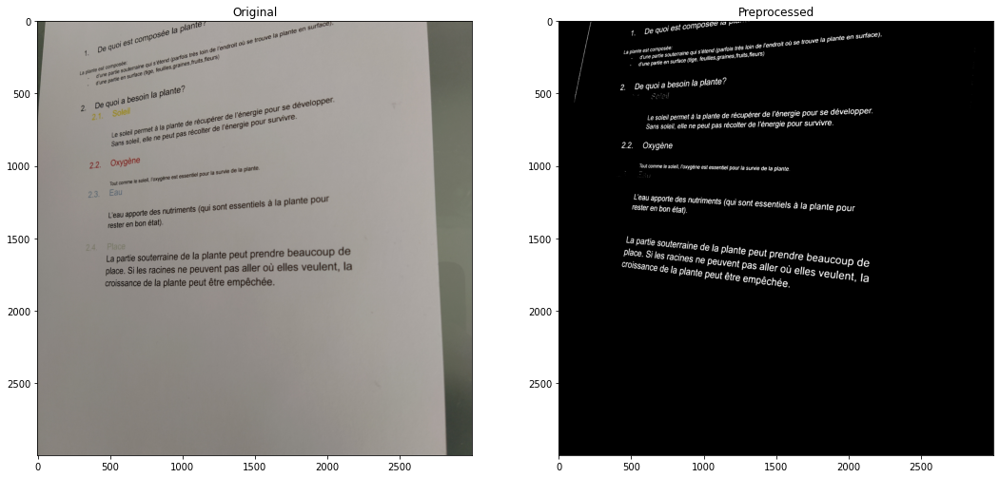

,Original,Preprocessed
0,"Jantuoi es composés laP rface); , (a plante en surf@as loin d€ rendroit où s€a plnte © sr ine (parfois ! © s, fleurs)D 4 rtie souterTa f fruits.- d'un rtie €_ De quoi à pesoin ja plan21 ili se développ€r.Le soleil permet à la plante de récupérery .ergle pso: 'sans soleil elle ne peut pas récolter de l'énerglé pourz OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de l ë93 Lau .L'eau apporte des nutrim — ,0 ents (qui sont essentiels à la plante pour2,4,coup dePlaceË|î ËÎÊ lsouterraine de la plante peut prendre be. Si les raci ‘racines ne peuvent pas aller où elles vZulent |,lacroissance de la plante peut être empêchée","1, De quoi est composéé 'E Hoù se trouve |à E CRN surface).La plante est composée: ' ‘ ' ‘p— d'une partie souterraine C[ s’étend (parfois très_ loin de l'endroitd'une partie en surface (tige, feuilles,graines, fruits, fleurs)2 De quoi a besoin la plante?2esLe soleil germet à la plante de récupérer de l’énergie pour se développer.ans soleil, elle ne peut pas récolter de l’énergie pour survivreTout comme le soleil, l'eil, l'oxygène est e jssentiel pour la surviRE R C ETE (L’eau apportedes nutri ;ester en bon éta triments (qui sont essentiels à la pl. plante pour"




../Exemples/SVT/IMG_20210329_122621.jpg
time preprocessed: 1.168s
time extract text from original: 5.206s
time extract text from preprocessed: 1.664s


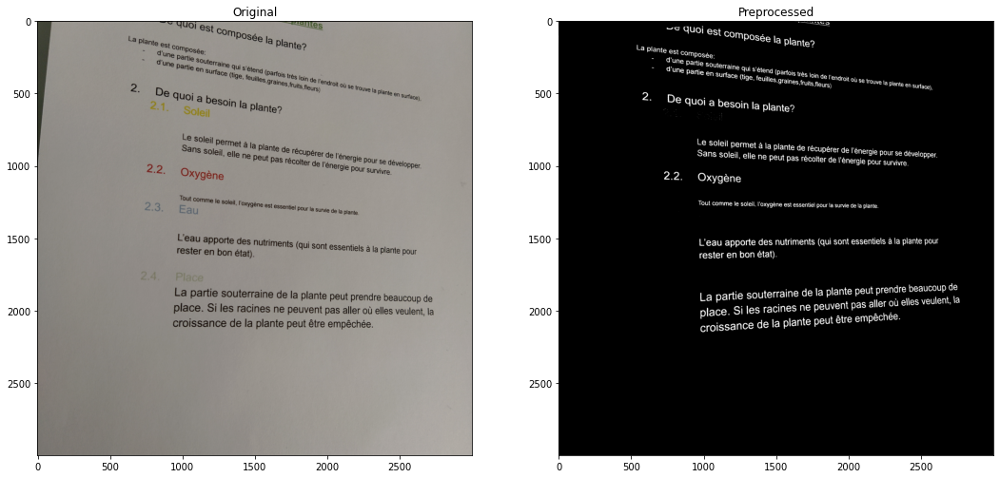

,Original,Preprocessed
0,"222s.S étend (Parfois trè€S,grainplante de rÉCUpérer de l’énergie pour se développer» elle ne peut pas récolter de l’énergie Ppour survivre.OxygèneTout comme le soleil, |’EauOXYygène est essentiel pour la Survie de la plante.L'eau apporte des nutriments (qui sont éssentiels à la plante pourrester en bon état).' re beaucoup deLa partie souterraine de la plante peut prenë 700lace. Si les racines ne peuvent pas aller où € ‘. : échée.Êroissance de la plante peut être empêc","ut—.c U Î Si GuUoi est CoOMposée [) plante?| La plante est Composée:d'une partie soute, TTaîne qui s'étend’une partie ensd (parfois très loiurface (tige, feuil! X} n de l'endroies.grames,fruitst OÙù se trouve la pifleurs) P'ante en surface),2. VD‘e QUoi a besoin la plante?Le soleil permet à laplante de récupérer de l’énerSans soleil, elle ne pgie pour se développer.eut pas récolter de l’énergiepour survivre.2.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).de,( ut prendre beaucoup- aine de la plante pe : tla2Pers lsouîgines ne peuvent pas aller où elles veulenRSI (RSn nce de la plante peut être empêchée.ecroiss"




../Exemples/SVT/IMG_20210329_122629.jpg
time preprocessed: 1.125s
time extract text from original: 5.333s
time extract text from preprocessed: 2.091s


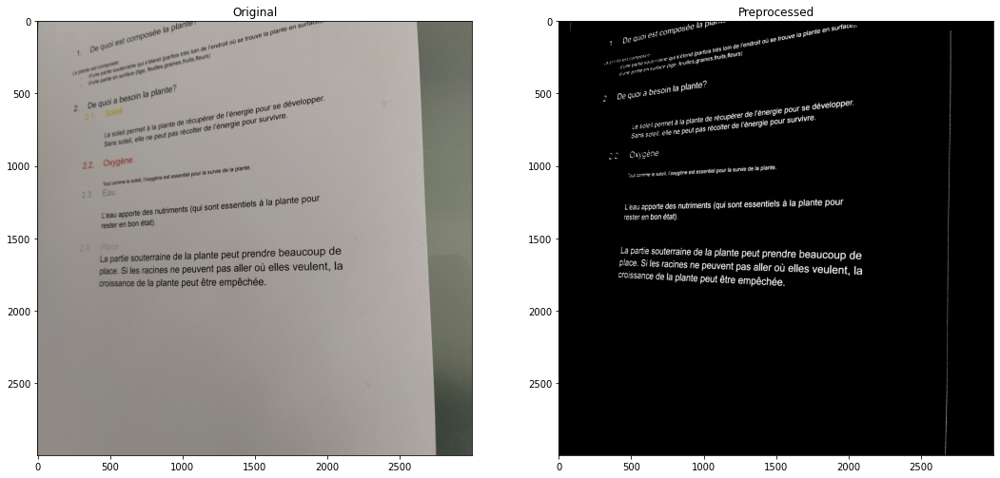

,Original,Preprocessed
0,"1.ureutt e q V (|n ::_,, partie W‘”:ä jeuiles.graines:| d‘WW“’“M‘ in la lante?pe quo! soin la Pse développe*2.21 soleilcupérer de rénergie POur *ie pour survivre.22 Oxygènéwmœwﬂ. l'oxygène93 Eaunt essentiels à la plante pL’eau apporte des nutriments (qui s0rester en bon état).est essentiel pour la survie de la plante.our2 Placeespartie souterraine de la plante peut prendre beaucoup de","CJe en surfa; Compose trouvé F plante| ; . de ! endroit où sein‘ “ H 'tÊ‘leurs)“ WîMr:';;rîr‘èe cqulerraine q ñ ;:::c partiê en sur)’ Jante :De quoi à pesoin la P er1| velopper-e pour se dé'énergie Poérer de l’é see epeae « fécuî de l'énergie pour survLescoitesans soleil, elle ne peut pas ré2 Oxygèneut COMM [ { n [= en lel oul la sur vie de |a p'a”te-e Vge ; .| rL'eau apporte des nutriments (qui sont essentiels à la plante pourester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123025.jpg
time preprocessed: 1.185s
time extract text from original: 4.941s
time extract text from preprocessed: 1.586s


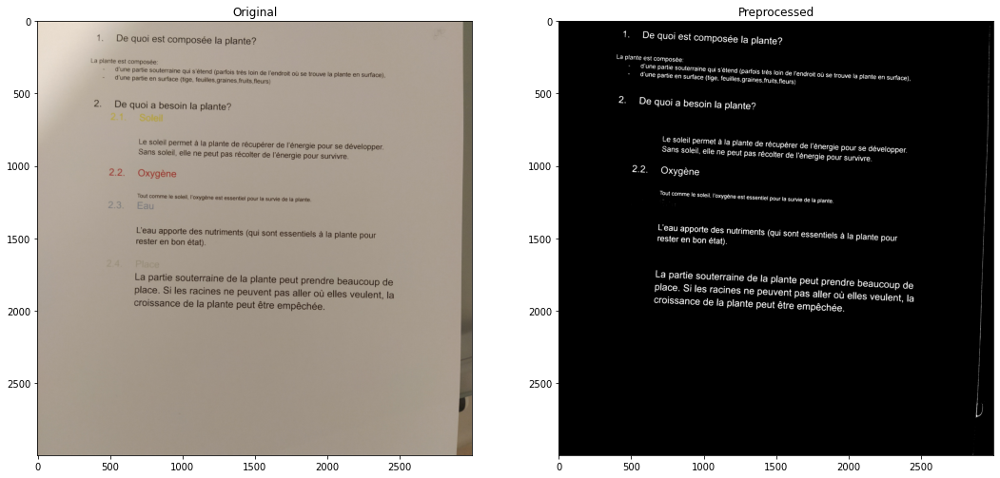

,Original,Preprocessed
0,"1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuilles.graines.ﬁuits,ﬂeurs)2. De quoi a besoin la plante?“l22SoleilLe soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","1. De quoi est composée la plante?La plante est composée:d'une partie Souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuifles.graines,ﬁuits.ﬂeurs)2. De quoi a besoin la plante?Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2.2. OxygèneTout comme le Soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines Ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123017.jpg
time preprocessed: 1.260s
time extract text from original: 4.059s
time extract text from preprocessed: 1.524s


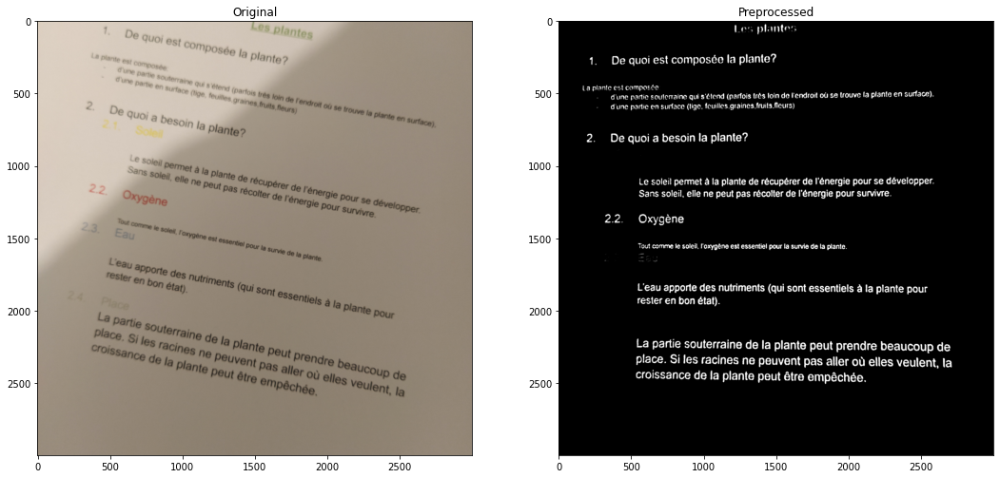

,Original,Preprocessed
0,,"Les plantes1. De quoi est composée la plante?La plante est compasée , ,d'une partie souterraine qui s'étend (parfois très toin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles graines fruits.fleurs)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récoiter de l'énergie pour survivre.OxygèneTout comme le soleil, l'oxygêne est essentiel pour la survie de la plante.s—L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123029.jpg
time preprocessed: 1.235s
time extract text from original: 5.218s
time extract text from preprocessed: 1.489s


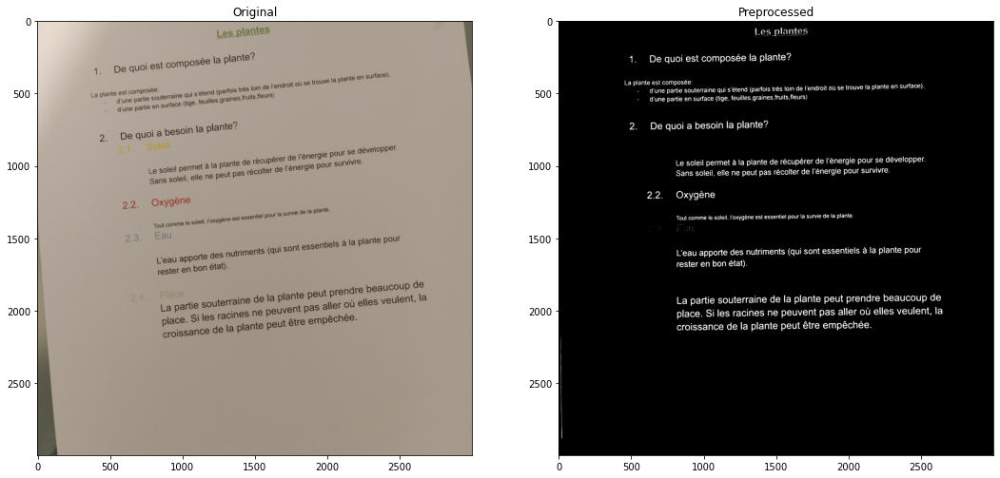

,Original,Preprocessed
0,"Les plantes4 Dequoi est composée |a p\ante?La plante est composée:- — d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve |a plante en surface).d'une partie en surface (tige, feuî\\es.graînes.ﬁuits.ﬂeurs). m quoi a besoin la p\ante?.. SoleilLe soleil permet à |a plante de récupérer de l’énergie pour se développer-Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour \a survie de la plante.934 5L'eau apporte des nutriments (qui sont essentiels à \a plante pourrester en bon état)La partie souterraine de la plante peut prendre beaucoup deplace. Sj les racines Né peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","Les plantes1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles graines, fruits, fleurs)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.1EL'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123132.jpg
time preprocessed: 2.650s
time extract text from original: 4.443s
time extract text from preprocessed: 3.944s


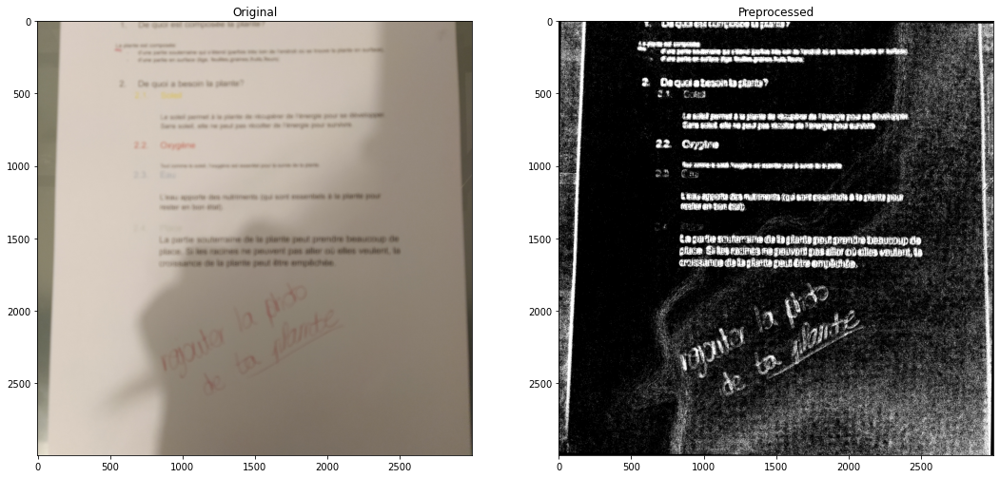

,Original,Preprocessed
0,ue6 N …… E es Ms S … é … E 6 6 S 0 se #sc e e p e Mlà uH ETE 4 6 E … S e AEE Ge E Nsé u8 @ (Rd e B0s u E OV Eéc 06 —— 20n 076 4… e Eu. wWaport t nl (G4 mt“scpctes 66r dn és,


In [14]:
subdir = subdir_paths[3]
files = [f for f in all_files if subdir in f]

results = analyse_pipeline(files)

### Check execution time

In [16]:
def time_mean(res, time_key):
    values = [v[time_key] for v in res.values()]
    
    return np.mean(values), np.std(values)

time_keys = {
    'loading': 'time_load',
    'preprocessing': 'time_preprocess',
    'extracting on original': 'time_res_original',
    'extracting on preprocessed': 'time_res_preprocess'
}

for time_str, time_key in time_keys.items():
    mean, std = time_mean(results, time_key)
    
    print('Time for %s: mean = %.1fs (std %.3fs)'%(time_str, mean, std))

Time for loading: mean = 0.3s (std 0.022s)
Time for preprocessing: mean = 1.3s (std 0.422s)
Time for extracting on original: mean = 4.8s (std 0.436s)
Time for extracting on preprocessed: mean = 1.8s (std 0.705s)


## Use pipeline on all examples 

../Exemples/Ex_Maths/IMG_20210329_123828.jpg
time preprocessed: 1.324s
time extract text from original: 4.092s
time extract text from preprocessed: 1.040s


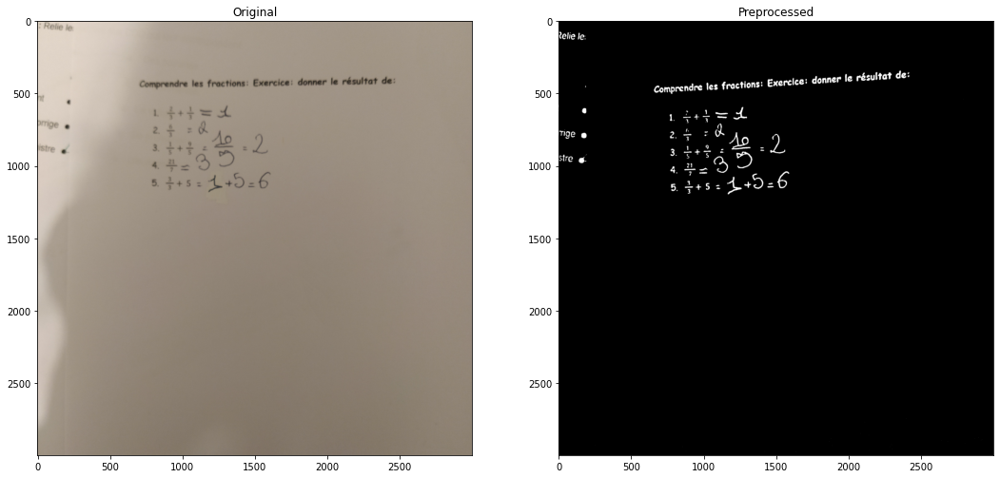

,Original,Preprocessed
0,,"telie le:Tige estre <Comprendre les fracti5 weNL S %.a""‘!-ﬂ œ‘=—_—« _æ‘.,$—w‘u _,!—+v|e_—*IV+ufY\> #1uE «+A°Kons: Exercice: donner le résuleONtat de:"




../Exemples/Ex_Maths/IMG_20210329_122221.jpg
time preprocessed: 1.071s
time extract text from original: 4.044s
time extract text from preprocessed: 0.697s


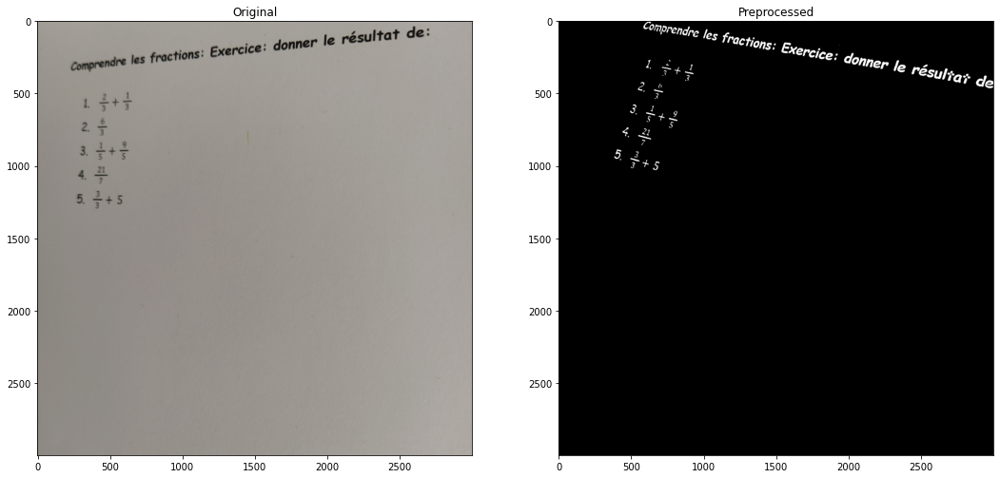

,Original,Preprocessed
0,deComprendre4>\'IÈÎ …’… w“} *»‘r—;+m'©wl…+L,




../Exemples/Ex_Maths/IMG_20210329_123818.jpg
time preprocessed: 1.077s
time extract text from original: 4.949s
time extract text from preprocessed: 0.746s


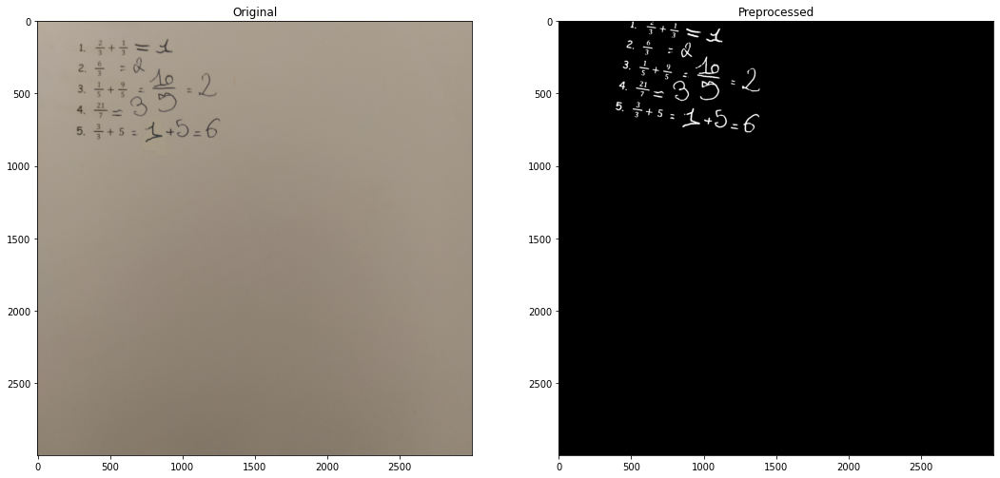

,Original,Preprocessed
0,"""—jes 9_S‘.|2—3 6—3 .I—5 es H = 3—3",




../Exemples/Ex_Maths/IMG_20210329_122227.jpg
time preprocessed: 1.072s
time extract text from original: 3.982s
time extract text from preprocessed: 0.645s


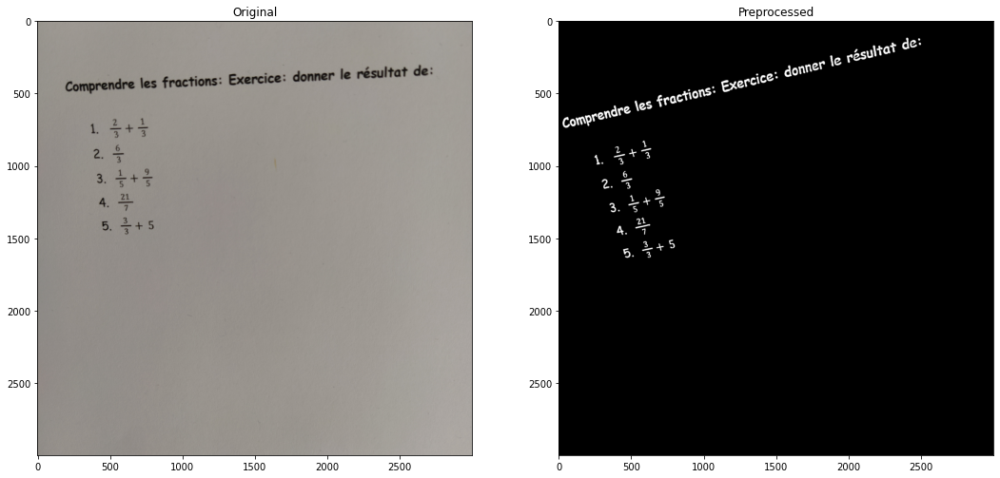

,Original,Preprocessed
0,"Comprendre les fractions: Exercice: donner le résultat de:L =+=2. =3 —+54. —B, —+5",at de*




../Exemples/Ex_Maths/IMG_20210329_122202.jpg
time preprocessed: 1.035s
time extract text from original: 4.131s
time extract text from preprocessed: 0.659s


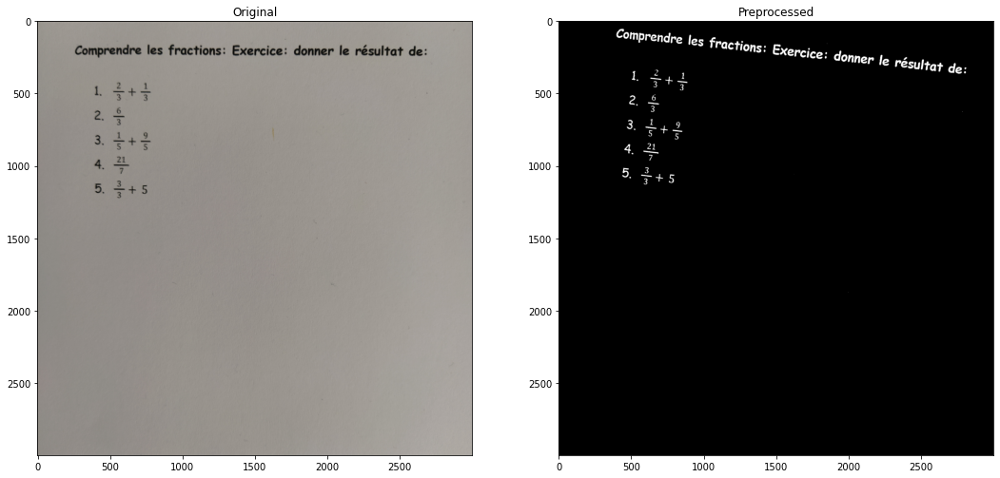

,Original,Preprocessed
0,Comprendre les fractions.Exercice: d: donnerle rérésultat de.L —3+'1“è =— ;3* =s+'2'4 — 575 =-+5,"e'l <, 1+32,3,4 215,"




../Exemples/Ex_Maths/IMG_20210329_122715.jpg
time preprocessed: 1.020s
time extract text from original: 3.927s
time extract text from preprocessed: 0.698s


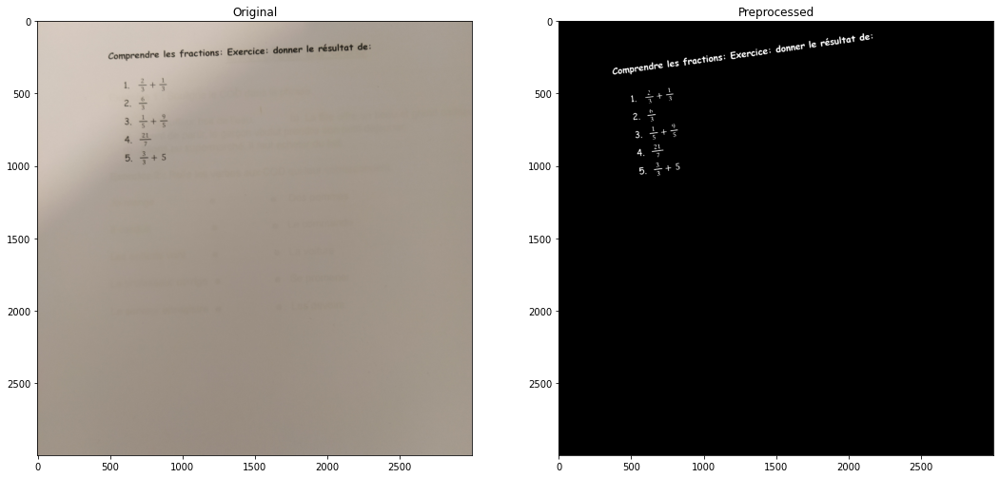

,Original,Preprocessed
0,,s fracﬁons: Exercice:




../Exemples/Ex_Maths/IMG_20210329_122724.jpg
time preprocessed: 1.055s
time extract text from original: 3.902s
time extract text from preprocessed: 0.708s


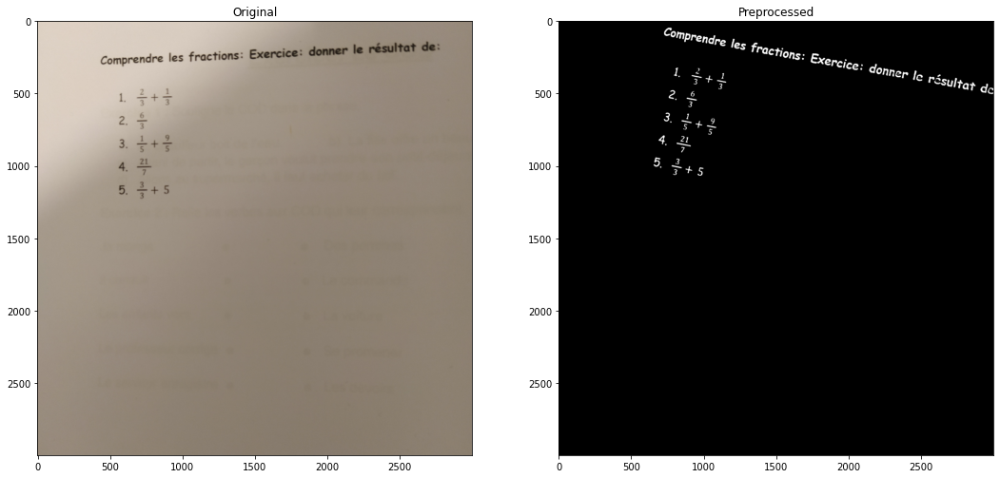

,Original,Preprocessed
0,,




../Exemples/Ex_Maths/IMG_20210329_123813.jpg
time preprocessed: 2.857s
time extract text from original: 4.942s
time extract text from preprocessed: 3.600s


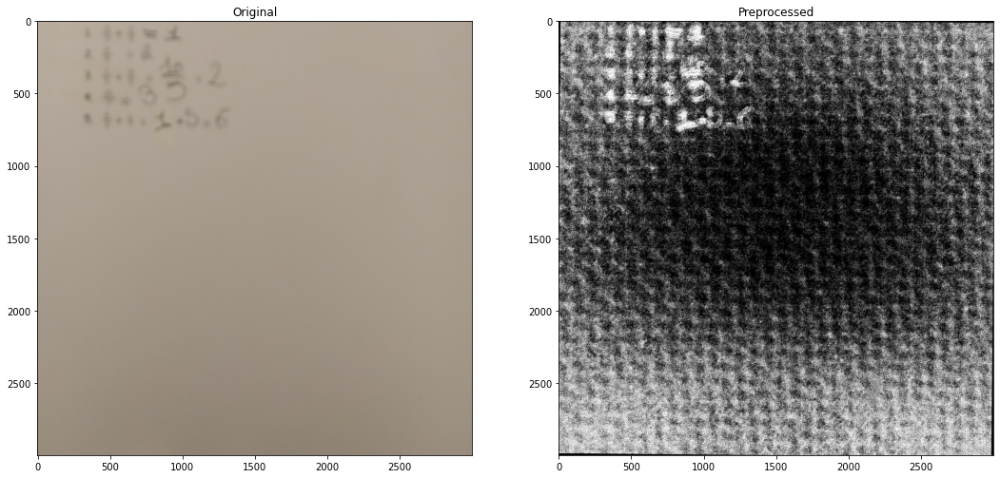

,Original,Preprocessed
0,,




../Exemples/Ex_Maths/IMG_20210329_122157.jpg
time preprocessed: 1.094s
time extract text from original: 4.175s
time extract text from preprocessed: 0.694s


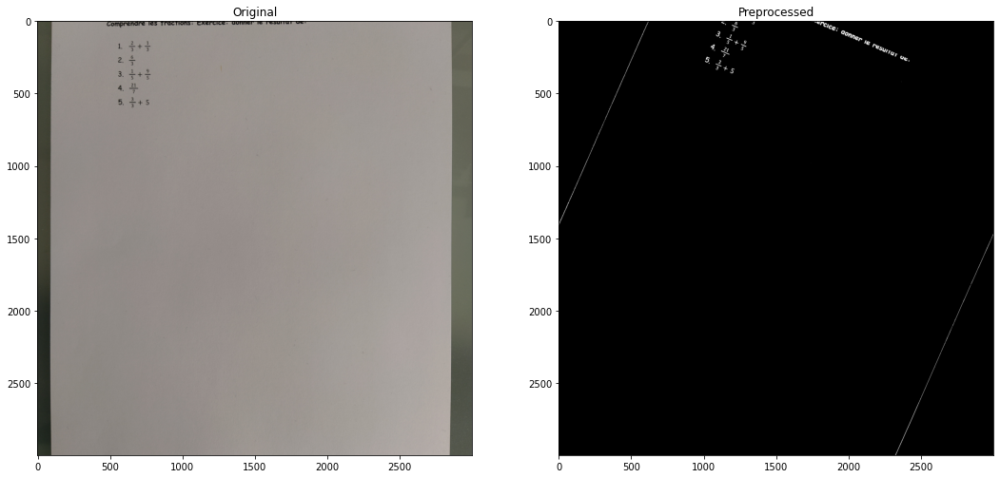

,Original,Preprocessed
0,Comprendare les TractTIons. CXErcICe. COMNET 16 TGSRTTRE RE*L++=2. =;s |4. —5.++5,“




../Exemples/Ex_Maths/IMG_20210329_122738.jpg
time preprocessed: 2.578s
time extract text from original: 3.982s
time extract text from preprocessed: 3.392s


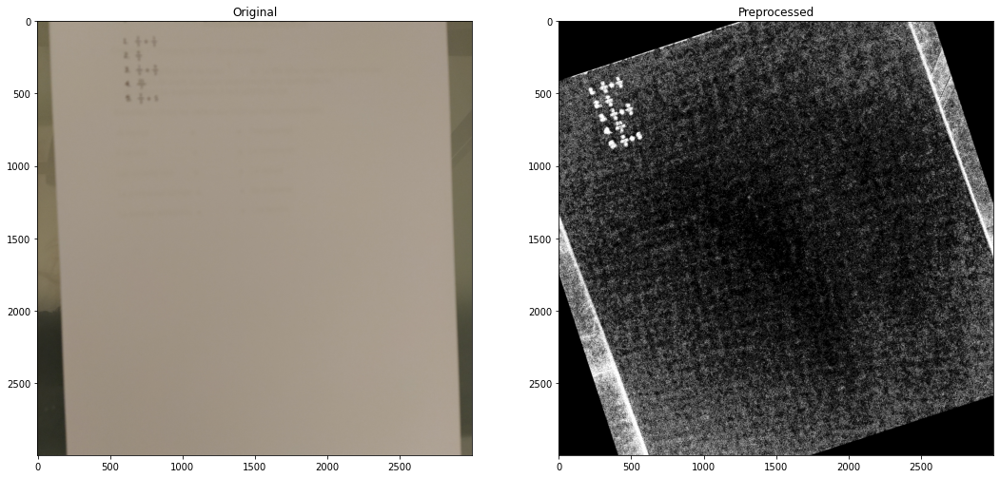

,Original,Preprocessed
0,,




../Exemples/Histoire_Geo/IMG_20210329_122543.jpg
time preprocessed: 1.193s
time extract text from original: 4.524s
time extract text from preprocessed: 1.495s


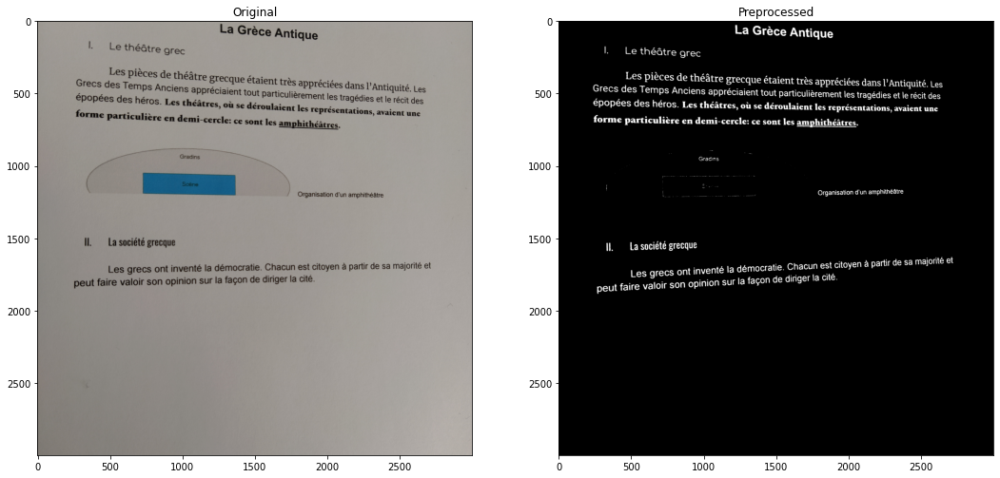

,Original,Preprocessed
0,La Grèce AntiqueL Lethéâtre grec; » où se déroulaient les représentationorme particulière en demi-cercle: ce sont les amphithéâtresp 10 Gradins\ - / Organisation d’un amphithéâtreC00Il — La société grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité.,"La Grèce Antique| Le théâtre grecLes pièces d 63e Atai NGrecs des Tîmps AnciËwîÏÿ Srecque étalent très appréciées dans l’Antiquité. Lespréciaient tout particulièrem s di '‘ ; ent les tragédies et le réciépopées d ‘ A \ ; g s et le récit desp es héros. Les théâtres, où se déroulaient les représentations, avaient uneforme particulière en demi-cercle: ce sont les amphithéâtresGradinsOrganisation d'un amphithéâtreI. — La société grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité."




../Exemples/Histoire_Geo/IMG_20210329_123005.jpg
time preprocessed: 1.223s
time extract text from original: 5.010s
time extract text from preprocessed: 0.954s


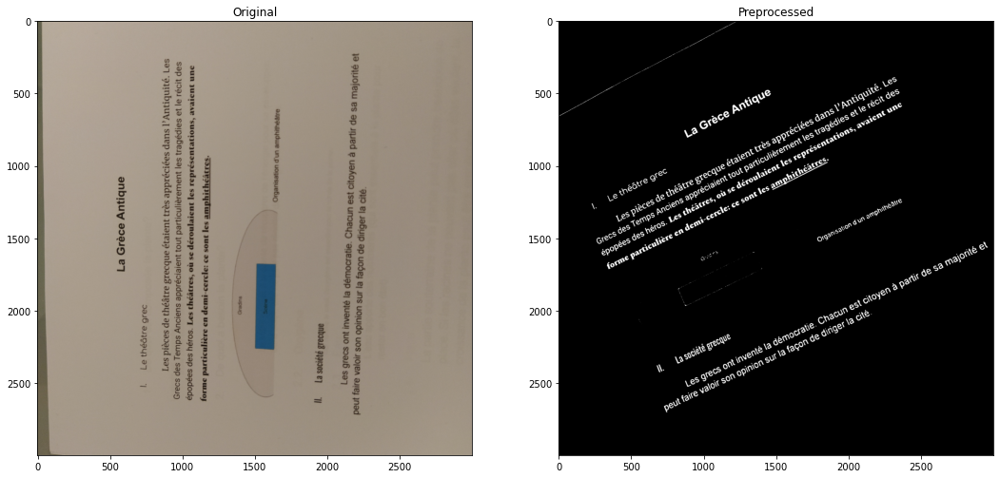

,Original,Preprocessed
0,"SU e| 1ÔLIP ap uodez ej ins vouIdo uos nojen aulE; }nad1D ]se unDeug ‘anerrowap e; SJU@AUI JUO SIAIÉ s97anbaelS ayaigose] |\ .,suipesomtscccSOITESYTYAUTE sJ Juos 55 :319150-TUIIP UD d121[HOIJIEd dULIOYoun juortae ‘suorpepuas91dau soj JuUdre[no1Ip ds no ‘saIJEIYI SIT ‘SOISUY SP saadodaSop }1991 9] 10 SaIpabe1] Sa| JuSWBIR(INOILEd }NO) JuallIOEIdde SUAIOUY SdWIE] Sop s215se7 ‘ay1nbquy,] suep soarardde sa1] JuareJe anbro1S 3138943 ap soderd saT2916 s130943 87 ""onbnuy 99819 BTlll-llll",




../Exemples/Histoire_Geo/IMG_20210329_122940.jpg
time preprocessed: 2.559s
time extract text from original: 3.994s
time extract text from preprocessed: 4.760s


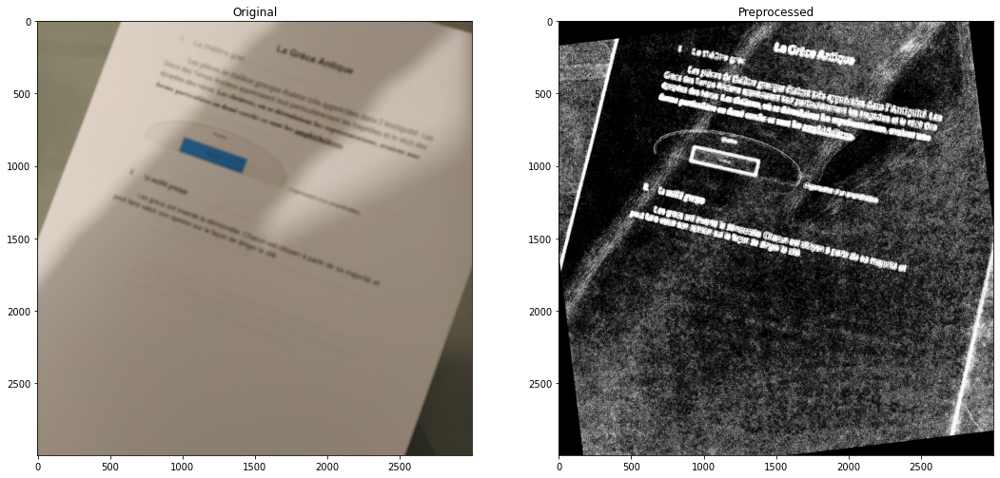

,Original,Preprocessed
0,,




../Exemples/Histoire_Geo/IMG_20210329_123000.jpg
time preprocessed: 1.182s
time extract text from original: 5.090s
time extract text from preprocessed: 0.911s


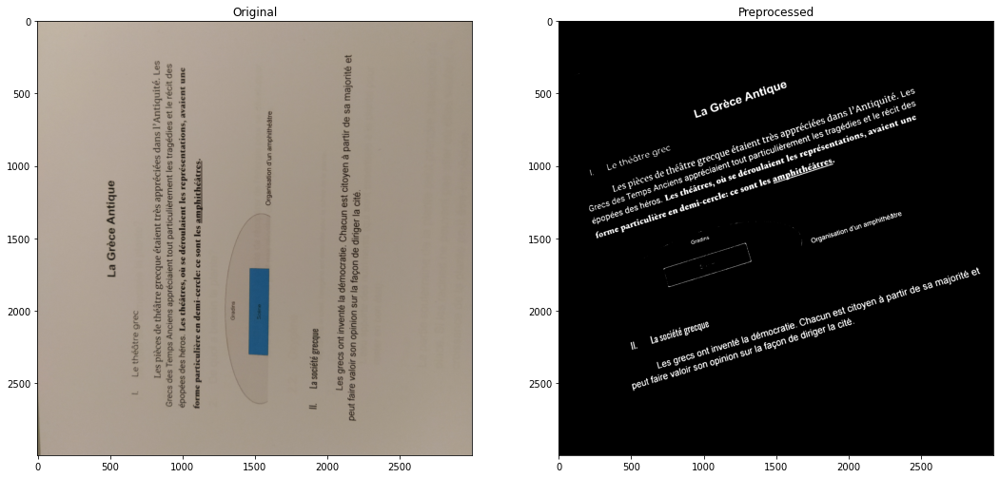

,Original,Preprocessed
0,QO E| JobLIP ap uoSe; e ins UOIUIdO UOS JIOJEA SuIE; jNad19 9Juolew es ap 11ued e U3A0}0 }s3 UNDEUT ‘@NEsIOLIEP EJ SJUBAUI JUO SIAIÉ s27anboa1s ajaigose] |\e“SHTJESYITYAUTE sI] JUOS 55 :3[9199-TIWDPp UI s191pMITUEd dULIOYoun JusIPAR ‘SsuoIJeJUISI1d51 SI JUIIE[NOJIPp dS NO ‘SIIJEIYI SIT ‘SOIÏSUY Sap SSadodasap 11921 a| 19 Saipabe1] sa| JUAWBAIZ(|NOILIEd }NO] JuallIOE1ddeE SUAIOUY SdWUA] Sap SIeIHsa] .œ.…?v::<…… suPp sag1D91dde sa17 Juore]a onbdo18 a13e9Y7 ap saderd saT29.16 a1109U2) 97 1onbijuy 09819 B7,




../Exemples/Histoire_Geo/IMG_20210329_122932.jpg
time preprocessed: 1.192s
time extract text from original: 4.827s
time extract text from preprocessed: 1.246s


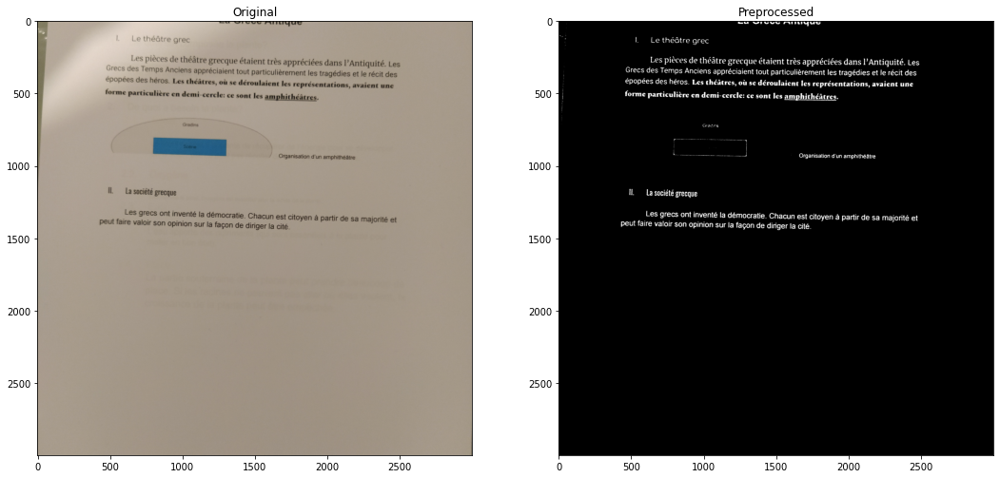

,Original,Preprocessed
0,"38 IVU S PUINMQUSthéâtre arecLes pièces de théâtre grecque étaient très appréciées dans l’Antiquité. Lescs des Temps Anciens appréciaient tout particulièrement les tragédies et le récit desépopées des héros. Les théâtres,\ÏH‘où se déroulaient les représentations, avaient uneforme particulière en demi-cercle: ce sont les ithéâGradinsï— / ;Organisation d’un amphithéâtreIl La société grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité.","La6i SE 00 PARIQSL Lethéâtre grecLes pièces de théâtre grecque étaient très appréciées dans l’Antiquité. LesGrecs des Temps Anciens appréciaient tout particulièrement les tragédies et le récit desépopées des héros. Les théâtres, où se déroulaient les représentations, avaient uneforme particulière en demi-cercle: ce sont les amphithéâtres.Gracdns Îb J Organisation d'un amphithéâtre. Lasociété grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité."




../Exemples/Histoire_Geo/IMG_20210329_122524.jpg
time preprocessed: 1.051s
time extract text from original: 3.083s
time extract text from preprocessed: 1.084s


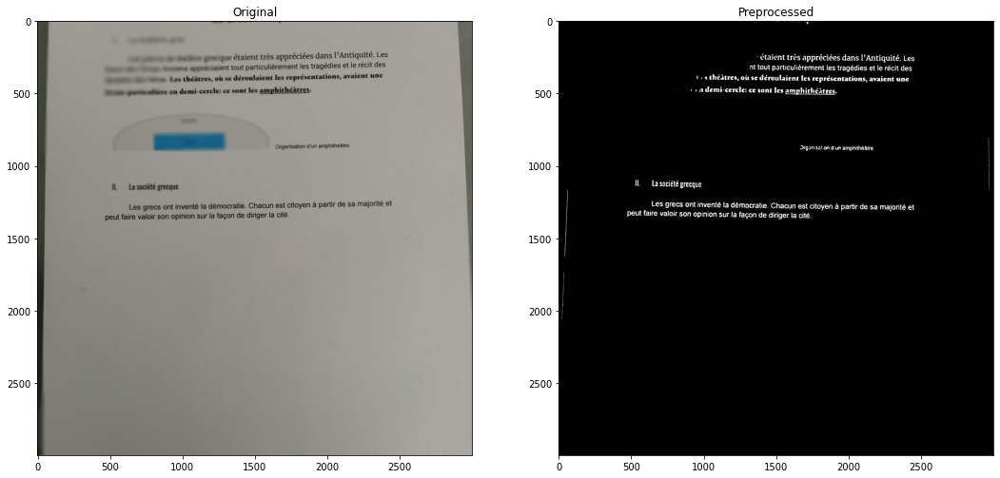

,Original,Preprocessed
0,"»» ""— e étaient très appréciées dans l’Antiquité. Les» —— — # tout particulièrement les tragédies et le récit des» — — Lus chéâtres, où se déroulaient les représentations, avaient une“ — en demi-cercle: ce sont les amphithéâtres.- Organisation d'un amphithéâtre. — La société grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité.","_ >-*->------ étaient très appréciées dans l’Antiquité. Les.nt tout particulièrement les tragédies et le récit des! - « théatres, où se déroulaient les représentations, avaient une- <ademi-cerclc: ce sont les amphithcitres.Organisation d'un amphithéâtrel Lasociété grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité."




../Exemples/Histoire_Geo/IMG_20210329_122536.jpg
time preprocessed: 1.137s
time extract text from original: 4.478s
time extract text from preprocessed: 1.351s


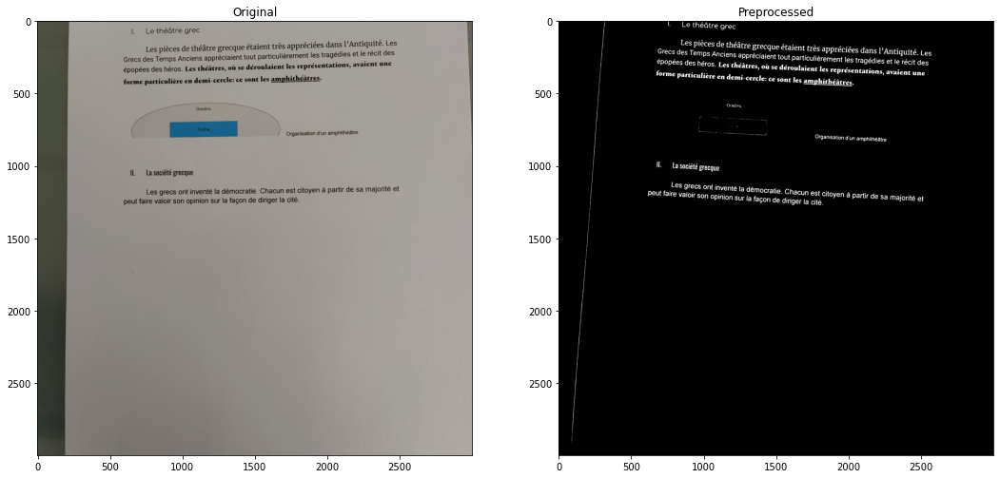

,Original,Preprocessed
0,"| Lethéâtre grecLes pièces de théâtre grecque étaient très appréciées dans l’Antiquité. LesGrecs des Temps Anciens appréciaient tout particulièrement les tragédies et le récit desépopées des héros. Les théâtres, où se déroulaient les représentations, avaient uneforme particulière en demi-cercle: ce sont les amphithéâtres.\ - / Organisation d'un amphithéâtreIl _ La société grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de sa majorité etpeut faire valoir son opinion sur la façon de diriger la cité.","L - Lethéâtre le1g—'eLes pièces de théâtre recque étaient très appréciées dans l’Antiquité. Leses Temps Anciens appréciaient tout particulièrement |es tragédies et le récit desépopées des héros. Les théâtres, où se déroulaient les repre'sentations,€: ce sont les amphithéâtres.Grecs davaient uneforme particulière en demi-cerciGradinsOrganisation d'un amphithéâtreH Lasociété grecqueLes grecs ont inventé la démocratie. Chacun est citoyen à partir de Sa majorité etpeut faire valoir son Opinion sur |a façon de diriger la cité."




../Exemples/Dictee/IMG_20210329_122324.jpg
time preprocessed: 1.191s
time extract text from original: 5.476s
time extract text from preprocessed: 1.870s


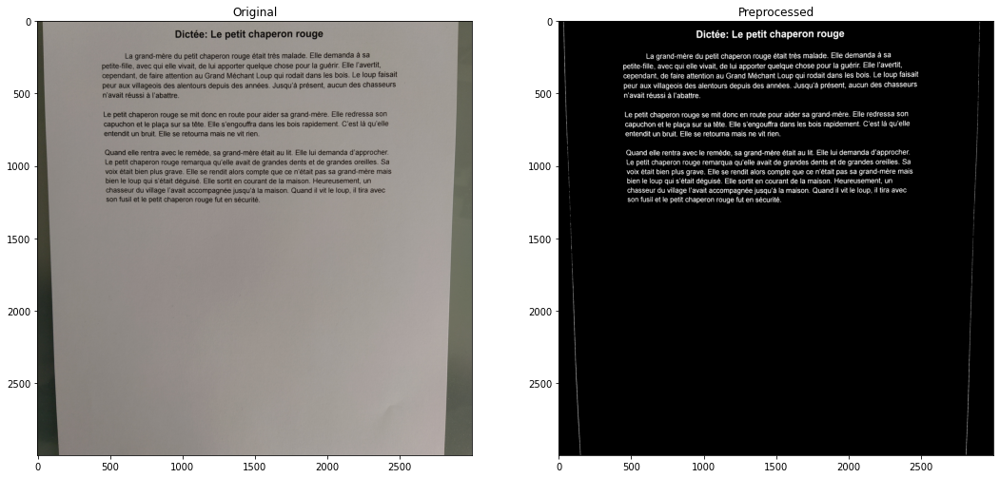

,Original,Preprocessed
0,"Dictée: Le petit chaperon rougeLa grand-mère du petit chaperon rouge était très malade. Elle demanda à sapetite-fille, avec qui elle vivait, de lui apporter quelque chose pour la guérir. Elle l’avertit, .cependant, de faire attention au Grand Méchant Loup qui rodait dans les bois. Le loup faisaitpeur aux villageois des alentours depuis des années. Jusqu’à présent, aucun des chasseursn'avait réussi à l’abattre.Le petit chaperon rouge se mit donc en route pour aider sa grand-mère. Elle redressa soncapuchon et le plaça sur sa tête. Elle s’engouffra dans les bois rapidement. C’est là qu’elleentendit un bruit. Elle se retourna mais ne vit rien.Quand elle rentra avec le remède, sa grand-mère était au lit. Elle lui demanda d’approcher.Le petit chaperon rouge remarqua qu’elle avait de grandes dents et de grandes oreilles. Savoix était bien plus grave. Elle se rendit alors compte que ce n’était pas sa grand-mère maisbien le loup qui s'était déguisé. Elle sortit en courant de la maison. Heureusement, unchasseur du village l’avait accompagnée jusqu’à la maison. Quand il vit le loup, il tira avecson fusil et le petit chaperon rouge fut en sécurité.","Dictée: Le petit chaperon rougeLa grand-mère du petit chaperon rouge était très malade. Elle demanda à sapetite-fille, avec qui elle vivait, de lui apporter quelque chose pour la guérir. Elle l'avertit, ,cependant, de faire attention au Grand Méchant Loup qui rodait dans les bois. Le loup faisaitpeur aux villageois des alentours depuis des années. Jusqu'à présent, aucun des chasseursn'avait réussi à l’abattre.Le petit chaperon rouge se mit donc en route pour aider sa grand-mère. Elle redressa soncapuchon et le plaça sur sa tête. Elle s'engouffra dans les bois rapidement. C’est là qu’elleentendit un bruit. Elle se retourna mais ne vit rien.Quand elle rentra avec le remède, sa grand-mère était au lit. Elle lui demanda d’approcher.Le petit chaperon rouge remarqua qu’elle avait de grandes dents et de grandes oreilles. Savoix était bien plus grave. Elle se rendit alors compte que ce n’était pas sa grand-mère maisbien le loup qui s'était déguisé. Elle sortit en courant de la maison. Heureusement, unchasseur du village l’avait accompagnée jusqu’à la maison. Quand il vit le loup, il tira avecson fusil et le petit chaperon rouge fut en sécurité."




../Exemples/Dictee/IMG_20210329_122825.jpg
time preprocessed: 2.293s
time extract text from original: 3.950s
time extract text from preprocessed: 3.860s


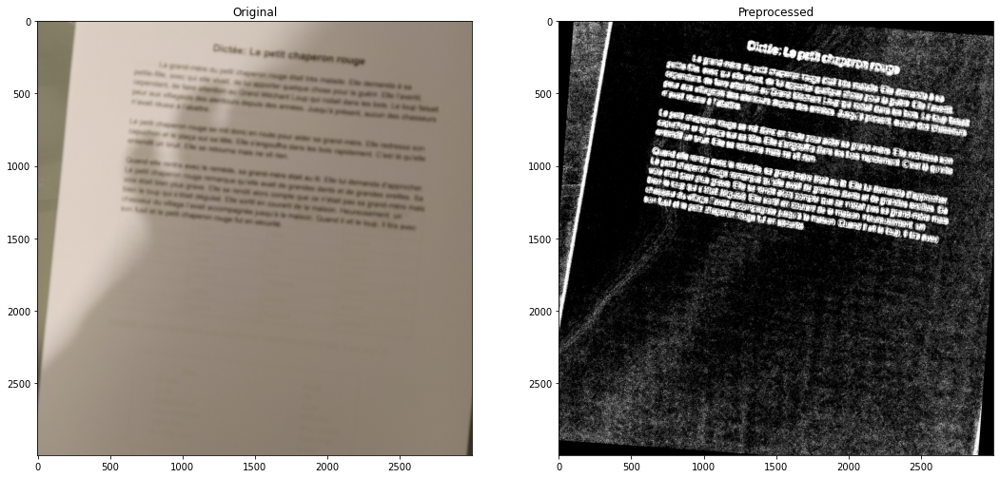

,Original,Preprocessed
0,,




../Exemples/Dictee/IMG_20210329_122839.jpg
time preprocessed: 1.173s
time extract text from original: 4.536s
time extract text from preprocessed: 1.857s


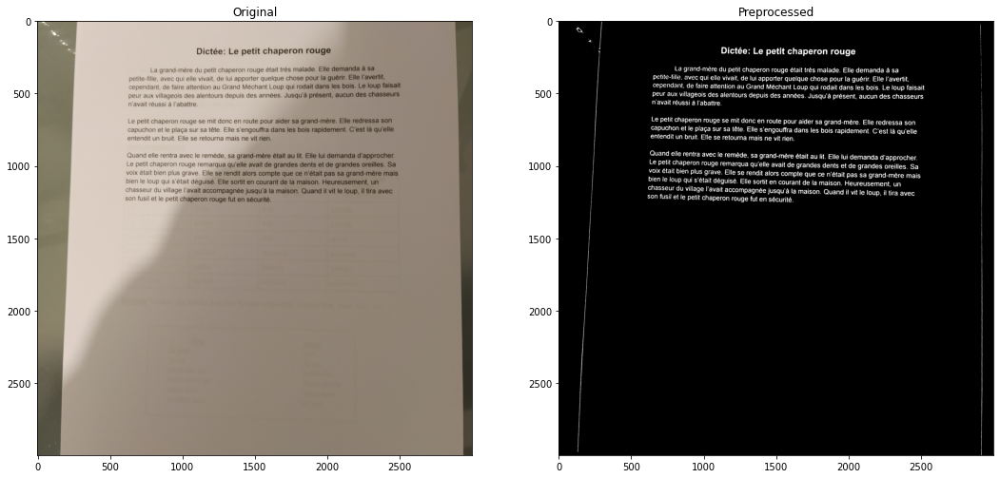

,Original,Preprocessed
0,"Dictée: Le petit chaperon roLa grand-mère du petit chaperon rouge était très mapetite-fille, avec qui elle vivait, de lui apporter quelque chosecependant, de faire attention au Grand Méchant Loup qui rod:peur aux villageois des alentours depuis des années. Jn'avait réussi à l'abattre. ;Le petit chaperon rouge se mit donc en routecapuchon et le plaça sur sa tête. Elle s'engaentendit un bruit. Elle se retourna mais ne vitQuand elle rentra avec le remède, sa gratLe petit chaperon rouge remarqua quvoix était bien plus grave. Elle sébien le loup qui s’était déchasseur du village l'avaitson fusil et le petit cha","Dictée: Le petit chaperon rougeLa grand-mère du petit chaperon rouge était très malade. Elle demanda à sapetite-fille, avec qui elle vivait, de lui apporter quelque chose pour la guérir. Elle l'avertit,cependant, de faire attention au Grand Méchant Loup qui rodait dans les bois. Le loup faisaitpeur aux villageois des alentours depuis des années. Jusqu'à présent, aucun des chasseursn'avait réussi à l'abattre.Le petit chaperon rouge se mit donc en route pour aider sa grand-mère. Eile redressa soncapuchon et le plaça sur sa tête. Elle s'engouffra dans les bois rapidement. C'est là qu'elleentendit un bruit. Elle se retourna mais ne vit rien.Quand elle rentra avec le remède, sa grand-mère était au lit. Elle lui demanda d'approcher.Le petit chaperon rouge remarqua qu'elle avait de grandes dents et de grandes oreilles. Savoix était bien plus grave. Elle se rendit alors compte que ce n'était pas sa grand-mère maisbien le loup qui s’était déguisé. Elle sortit en courant de la maison. Heureusement, unchasseur du village l'avait accompagnée jusqu'à la maison. Quand il vit le loup, il tira avecson fusil et le petit chaperon rouge fut en sécurité."




../Exemples/Dictee/IMG_20210329_122828.jpg
time preprocessed: 1.233s
time extract text from original: 4.262s
time extract text from preprocessed: 1.539s


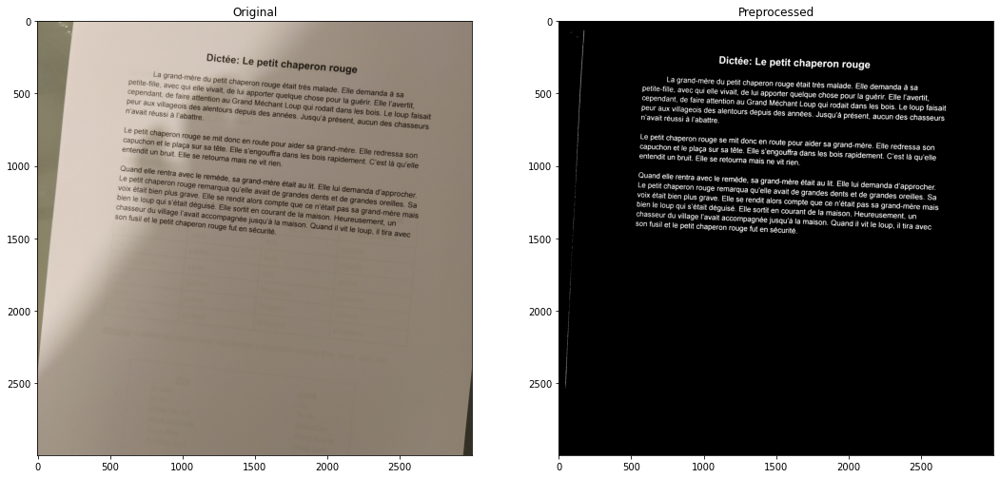

,Original,Preprocessed
0,"La grand-mère du petitpetite-fille, avec qui elle viyCependant, de faire attpeur aux villageois den'avait réussi à l'a D-© petit chaperon o<apuchon et le plaentendit un bruit. EllQuandLe pe î{Voix étaibien le |","Dictée: Le petit chaperon rougeLa grand-mère du petit chaperon rouge était très malade. Elle demanda à sa |petite-fille, avec qui elle vivait, de lui apporter quelque chose pour la guérir. Elle l’avertit, ,cependant, de faire attention au Grand Méchant Loup qui rodait dans les bois. Le loup faisaitLe petit chaperon rouge se mit donc en route pour aider sa grand-mère. Elle redressa soncapuchon et le plaça sur sa tête. Elle s’engouffra dans les bois rapidement. C’est |à qu'’elleentendit un bruit. Elle se retourna mais ne vit rien.Quand elle rentra avec le remède, sa grand-mère était au lit. Elle lui demanda d’approcher.Le petit chaperon rouge remarqua qu’elle avait de grandes dents et de grandes oreilles. Sa"




../Exemples/SVT/IMG_20210329_123138.jpg
time preprocessed: 1.164s
time extract text from original: 4.576s
time extract text from preprocessed: 1.594s


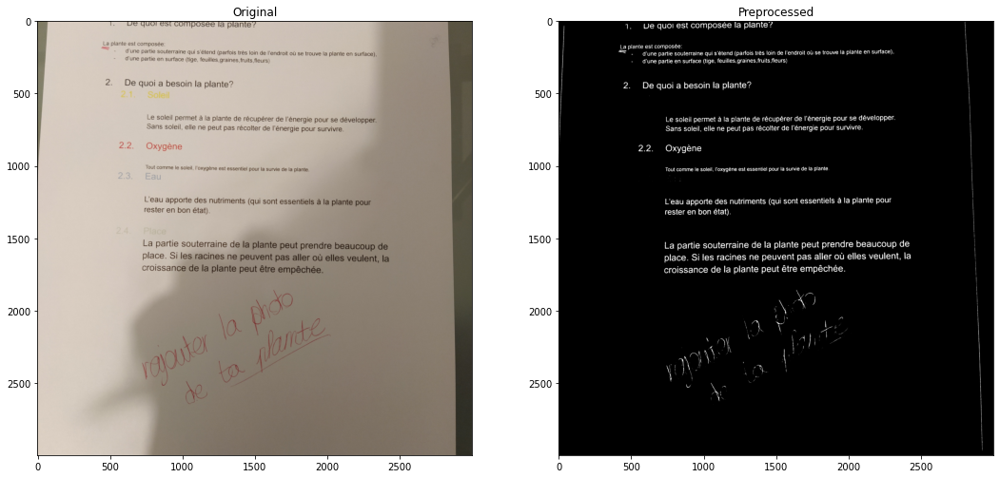

,Original,Preprocessed
0,"ve quoil e€st composee la plante’La plante est composée:=—d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines , fruits,fleurs)2. De quoi a besoin la plante?.SoleilLe soleil permet à la plante de récupérer de l'énergie pour se développSans soleil, elle ne peut pas récolter de l'énergie pour survivre.OxygèneTout comme le soleil, l’oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentierester en bon état).La partie souterraine deplace. Si les racine:croissanc","1. LUe quoi est composée la plante ?La piante est composée:# - _ d'une partie souterraine qui s’étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante”Le soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2.2. OxygèneTout comme le soleil, l’oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.>Le/\.- A ;e p| ñ> . , (R*py\ ﬁ\( e \ A } ; g | 7!——sLV"




../Exemples/SVT/IMG_20210329_122617.jpg
time preprocessed: 1.215s
time extract text from original: 4.951s
time extract text from preprocessed: 1.450s


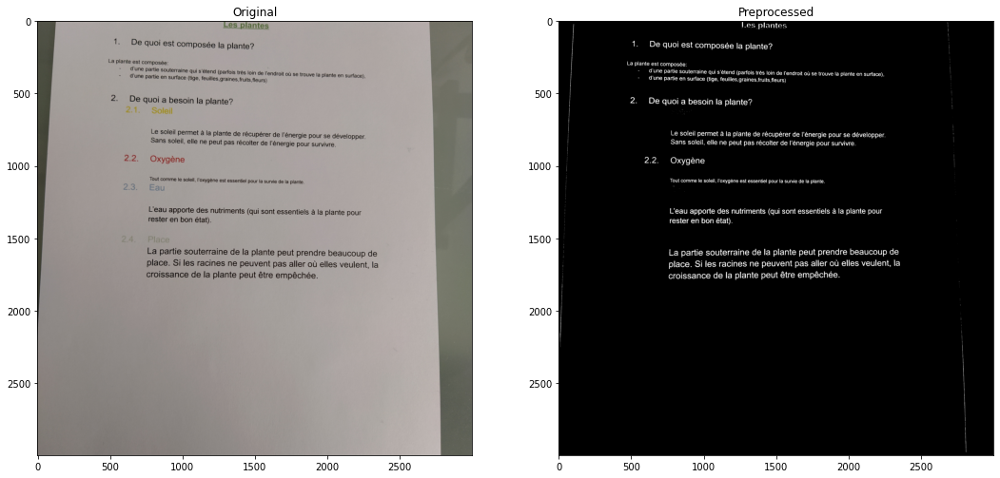

,Original,Preprocessed
0,"Les plantes1. De quoi est composée la plante?La plante est composée: -- d’'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines.ﬁuits,ﬂeuœ)2. De quoi a besoin la plante?’tAeSoleilLe soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).PlaceLa partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","les plantes1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- d'une partie en surface (tige, feuilles,graines, fruits,fleurs)2. De quoi a besoin la plante?Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.2.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_122614.jpg
time preprocessed: 1.124s
time extract text from original: 4.814s
time extract text from preprocessed: 1.636s


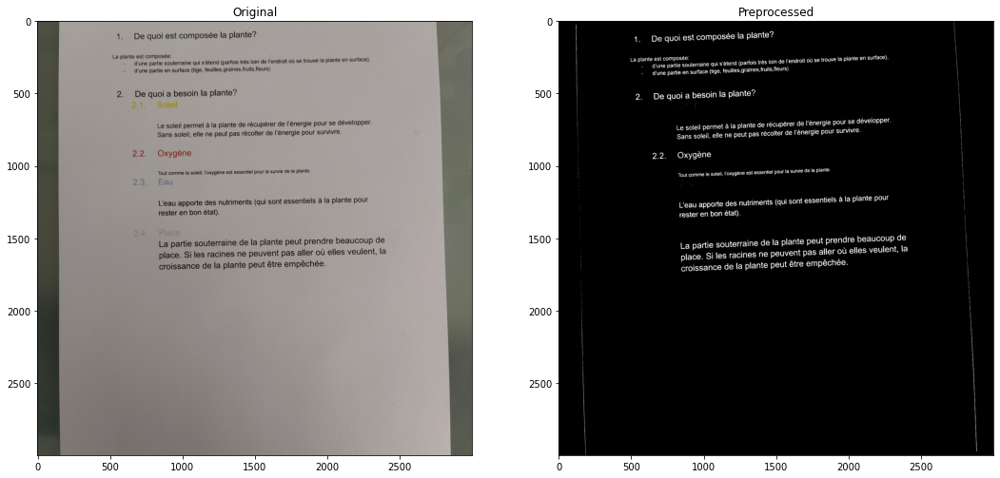

,Original,Preprocessed
0,"1. De quoi est composée la plante?La plante est composée:- _ d’une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),- _ d’une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante?dh222.eSoleilLe soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).p3j pnriactLa partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","1. De quoi est composée la plante?La plante est composée:d'une partie souterraine eESXA GU R CEUCAUSS toin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles.graines,fmits,ﬂeura)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123021.jpg
time preprocessed: 1.301s
time extract text from original: 4.283s
time extract text from preprocessed: 1.526s


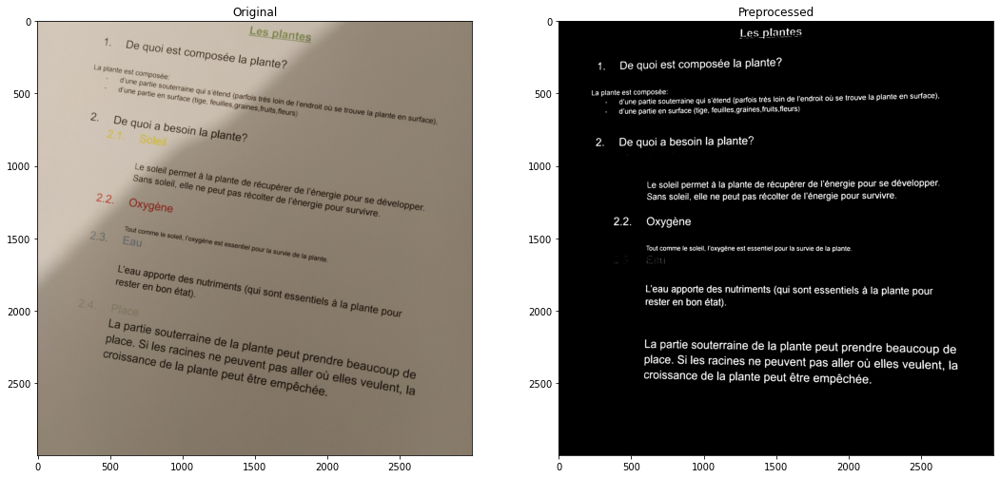

,Original,Preprocessed
0,,"Les plantes1. De quoi est composée la plante?La plante est composée: ,° d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d’une partie en surface (tige, feuilles,graines,fruits,fleurs)2. De quoi a besoin la plante”2.2.Le soleil permet à la plante de récupérer de l’_énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_122633.jpg
time preprocessed: 1.136s
time extract text from original: 5.181s
time extract text from preprocessed: 1.324s


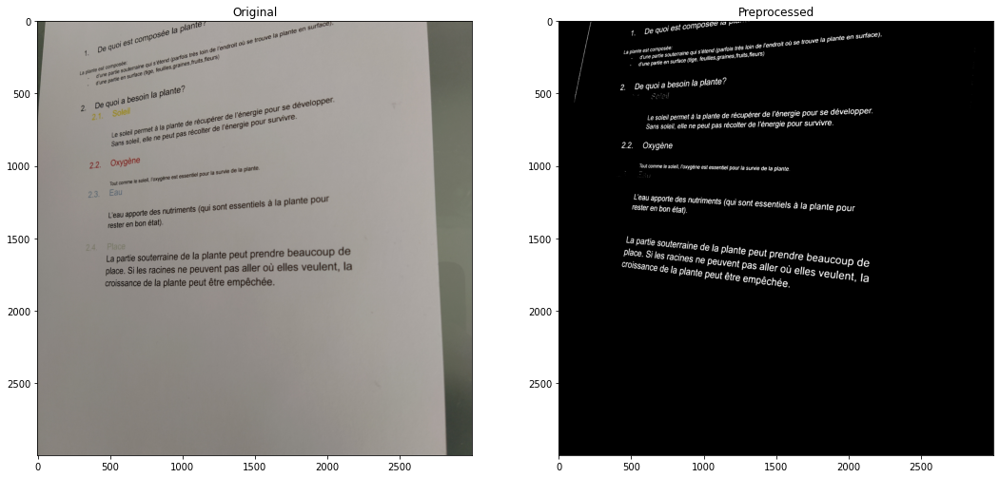

,Original,Preprocessed
0,"Jantuoi es composés laP rface); , (a plante en surf@as loin d€ rendroit où s€a plnte © sr ine (parfois ! © s, fleurs)D 4 rtie souterTa f fruits.- d'un rtie €_ De quoi à pesoin ja plan21 ili se développ€r.Le soleil permet à la plante de récupérery .ergle pso: 'sans soleil elle ne peut pas récolter de l'énerglé pourz OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de l ë93 Lau .L'eau apporte des nutrim — ,0 ents (qui sont essentiels à la plante pour2,4,coup dePlaceË|î ËÎÊ lsouterraine de la plante peut prendre be. Si les raci ‘racines ne peuvent pas aller où elles vZulent |,lacroissance de la plante peut être empêchée","1, De quoi est composéé 'E Hoù se trouve |à E CRN surface).La plante est composée: ' ‘ ' ‘p— d'une partie souterraine C[ s’étend (parfois très_ loin de l'endroitd'une partie en surface (tige, feuilles,graines, fruits, fleurs)2 De quoi a besoin la plante?2esLe soleil germet à la plante de récupérer de l’énergie pour se développer.ans soleil, elle ne peut pas récolter de l’énergie pour survivreTout comme le soleil, l'eil, l'oxygène est e jssentiel pour la surviRE R C ETE (L’eau apportedes nutri ;ester en bon éta triments (qui sont essentiels à la pl. plante pour"




../Exemples/SVT/IMG_20210329_122621.jpg
time preprocessed: 1.249s
time extract text from original: 4.910s
time extract text from preprocessed: 1.651s


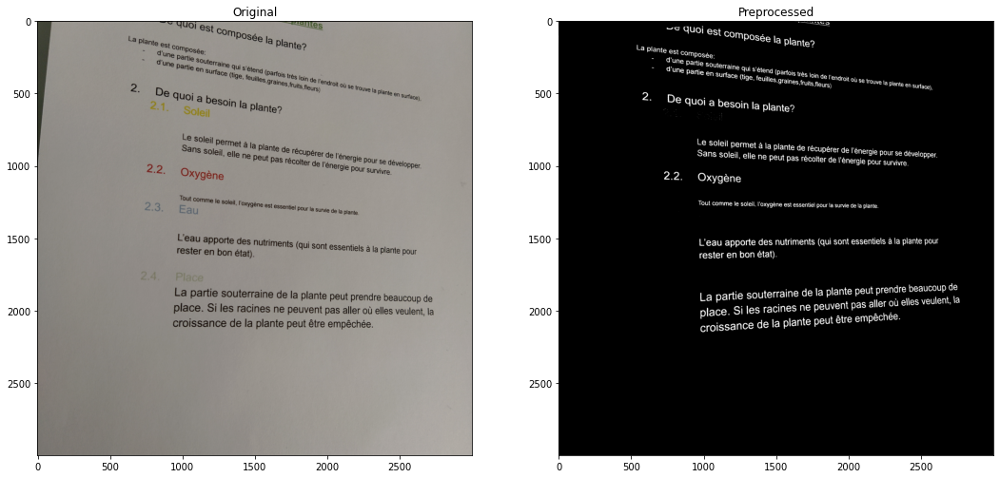

,Original,Preprocessed
0,"222s.S étend (Parfois trè€S,grainplante de rÉCUpérer de l’énergie pour se développer» elle ne peut pas récolter de l’énergie Ppour survivre.OxygèneTout comme le soleil, |’EauOXYygène est essentiel pour la Survie de la plante.L'eau apporte des nutriments (qui sont éssentiels à la plante pourrester en bon état).' re beaucoup deLa partie souterraine de la plante peut prenë 700lace. Si les racines ne peuvent pas aller où € ‘. : échée.Êroissance de la plante peut être empêc","ut—.c U Î Si GuUoi est CoOMposée [) plante?| La plante est Composée:d'une partie soute, TTaîne qui s'étend’une partie ensd (parfois très loiurface (tige, feuil! X} n de l'endroies.grames,fruitst OÙù se trouve la pifleurs) P'ante en surface),2. VD‘e QUoi a besoin la plante?Le soleil permet à laplante de récupérer de l’énerSans soleil, elle ne pgie pour se développer.eut pas récolter de l’énergiepour survivre.2.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).de,( ut prendre beaucoup- aine de la plante pe : tla2Pers lsouîgines ne peuvent pas aller où elles veulenRSI (RSn nce de la plante peut être empêchée.ecroiss"




../Exemples/SVT/IMG_20210329_122629.jpg
time preprocessed: 1.116s
time extract text from original: 5.021s
time extract text from preprocessed: 2.013s


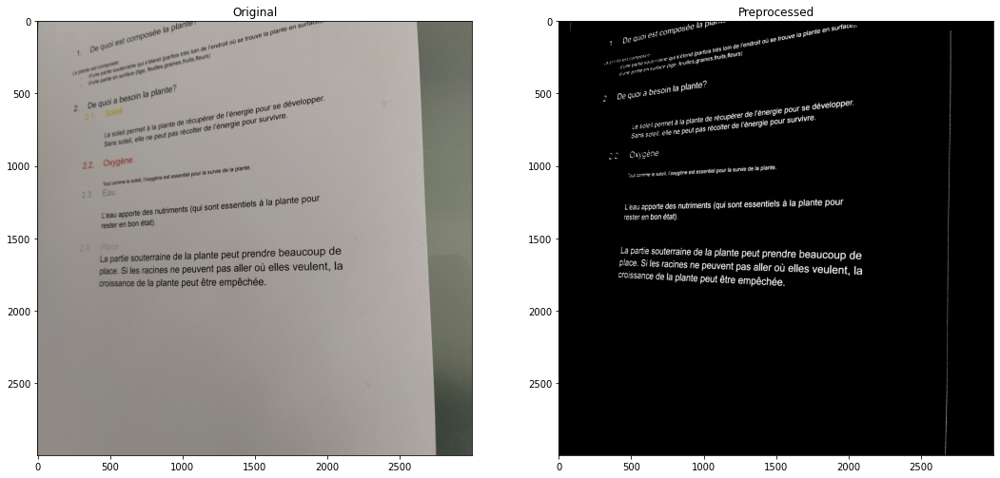

,Original,Preprocessed
0,"1.ureutt e q V (|n ::_,, partie W‘”:ä jeuiles.graines:| d‘WW“’“M‘ in la lante?pe quo! soin la Pse développe*2.21 soleilcupérer de rénergie POur *ie pour survivre.22 Oxygènéwmœwﬂ. l'oxygène93 Eaunt essentiels à la plante pL’eau apporte des nutriments (qui s0rester en bon état).est essentiel pour la survie de la plante.our2 Placeespartie souterraine de la plante peut prendre beaucoup de","CJe en surfa; Compose trouvé F plante| ; . de ! endroit où sein‘ “ H 'tÊ‘leurs)“ WîMr:';;rîr‘èe cqulerraine q ñ ;:::c partiê en sur)’ Jante :De quoi à pesoin la P er1| velopper-e pour se dé'énergie Poérer de l’é see epeae « fécuî de l'énergie pour survLescoitesans soleil, elle ne peut pas ré2 Oxygèneut COMM [ { n [= en lel oul la sur vie de |a p'a”te-e Vge ; .| rL'eau apporte des nutriments (qui sont essentiels à la plante pourester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123025.jpg
time preprocessed: 1.185s
time extract text from original: 4.858s
time extract text from preprocessed: 1.517s


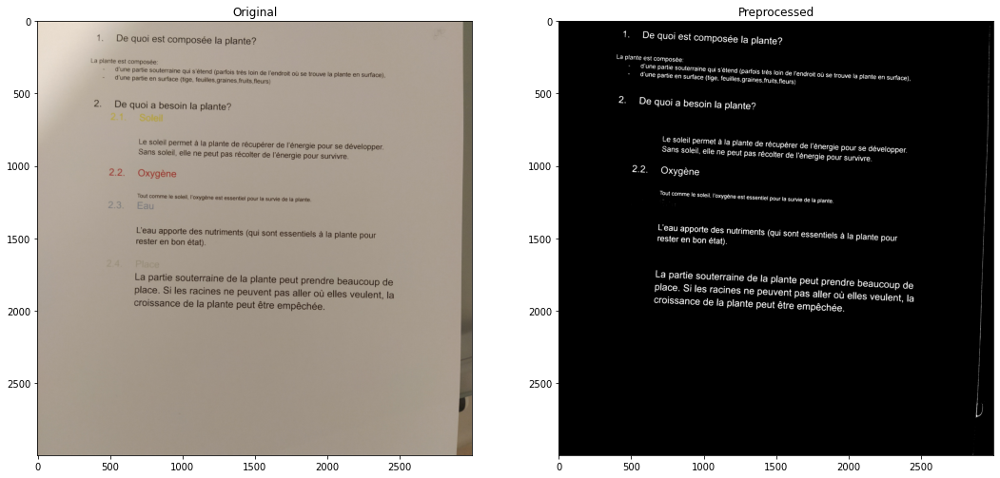

,Original,Preprocessed
0,"1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuilles.graines.ﬁuits,ﬂeurs)2. De quoi a besoin la plante?“l22SoleilLe soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l’énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.EauL'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","1. De quoi est composée la plante?La plante est composée:d'une partie Souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface),d'une partie en surface (tige, feuifles.graines,ﬁuits.ﬂeurs)2. De quoi a besoin la plante?Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2.2. OxygèneTout comme le Soleil, l'oxygène est essentiel pour la survie de la plante.L’eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines Ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123017.jpg
time preprocessed: 1.282s
time extract text from original: 4.012s
time extract text from preprocessed: 1.576s


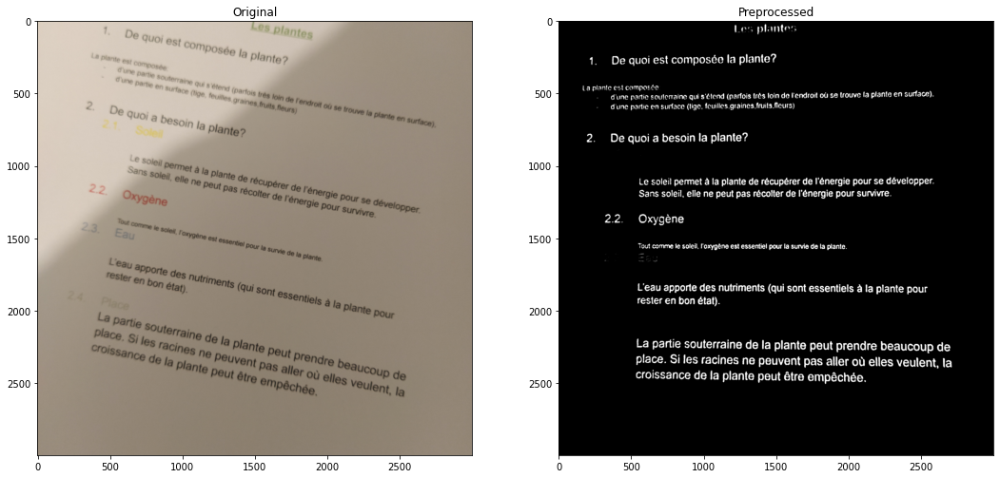

,Original,Preprocessed
0,,"Les plantes1. De quoi est composée la plante?La plante est compasée , ,d'une partie souterraine qui s'étend (parfois très toin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles graines fruits.fleurs)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l'énergie pour se développer.Sans soleil, elle ne peut pas récoiter de l'énergie pour survivre.OxygèneTout comme le soleil, l'oxygêne est essentiel pour la survie de la plante.s—L'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123029.jpg
time preprocessed: 1.203s
time extract text from original: 5.329s
time extract text from preprocessed: 1.533s


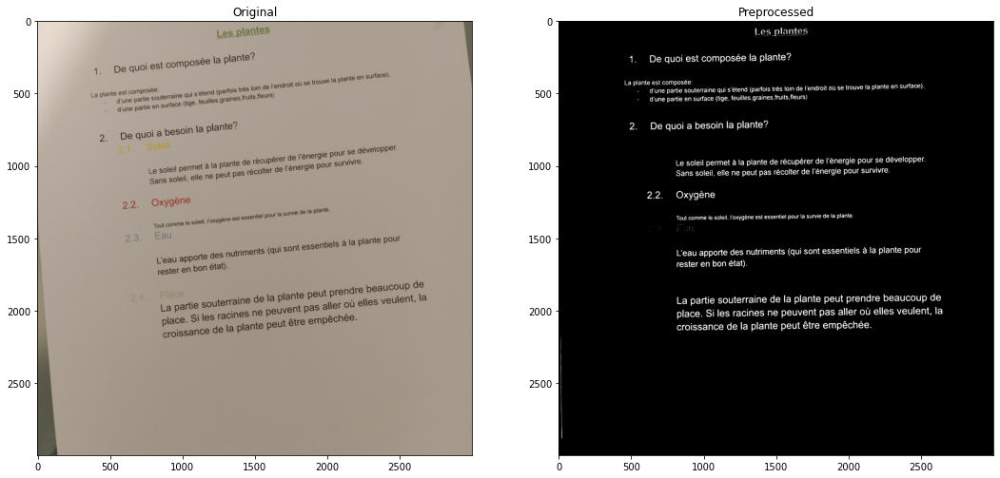

,Original,Preprocessed
0,"Les plantes4 Dequoi est composée |a p\ante?La plante est composée:- — d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve |a plante en surface).d'une partie en surface (tige, feuî\\es.graînes.ﬁuits.ﬂeurs). m quoi a besoin la p\ante?.. SoleilLe soleil permet à |a plante de récupérer de l’énergie pour se développer-Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.2. OxygèneTout comme le soleil, l'oxygène est essentiel pour \a survie de la plante.934 5L'eau apporte des nutriments (qui sont essentiels à \a plante pourrester en bon état)La partie souterraine de la plante peut prendre beaucoup deplace. Sj les racines Né peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée.","Les plantes1. De quoi est composée la plante?La plante est composée:d'une partie souterraine qui s'étend (parfois très loin de l'endroit où se trouve la plante en surface).d'une partie en surface (tige, feuilles graines, fruits, fleurs)2. De quoi a besoin la plante?2.2.Le soleil permet à la plante de récupérer de l’énergie pour se développer.Sans soleil, elle ne peut pas récolter de l'énergie pour survivre.OxygèneTout comme le soleil, l'oxygène est essentiel pour la survie de la plante.1EL'eau apporte des nutriments (qui sont essentiels à la plante pourrester en bon état).La partie souterraine de la plante peut prendre beaucoup deplace. Si les racines ne peuvent pas aller où elles veulent, lacroissance de la plante peut être empêchée."




../Exemples/SVT/IMG_20210329_123132.jpg
time preprocessed: 2.541s
time extract text from original: 4.620s
time extract text from preprocessed: 4.447s


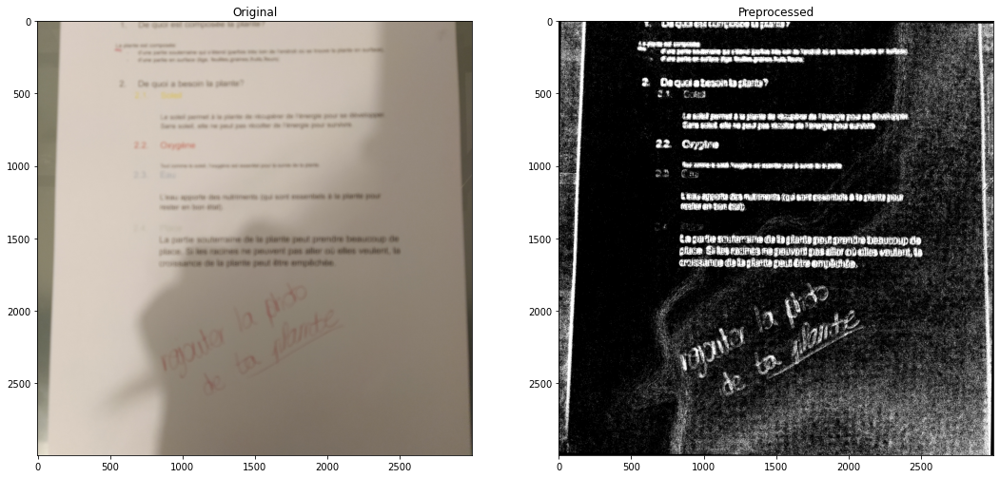

,Original,Preprocessed
0,ue6 N …… E es Ms S … é … E 6 6 S 0 se #sc e e p e Mlà uH ETE 4 6 E … S e AEE Ge E Nsé u8 @ (Rd e B0s u E OV Eéc 06 —— 20n 076 4… e Eu. wWaport t nl (G4 mt“scpctes 66r dn és,




../Exemples/Ex_COD/IMG_20210329_122814.jpg
time preprocessed: 1.289s
time extract text from original: 4.309s
time extract text from preprocessed: 1.241s


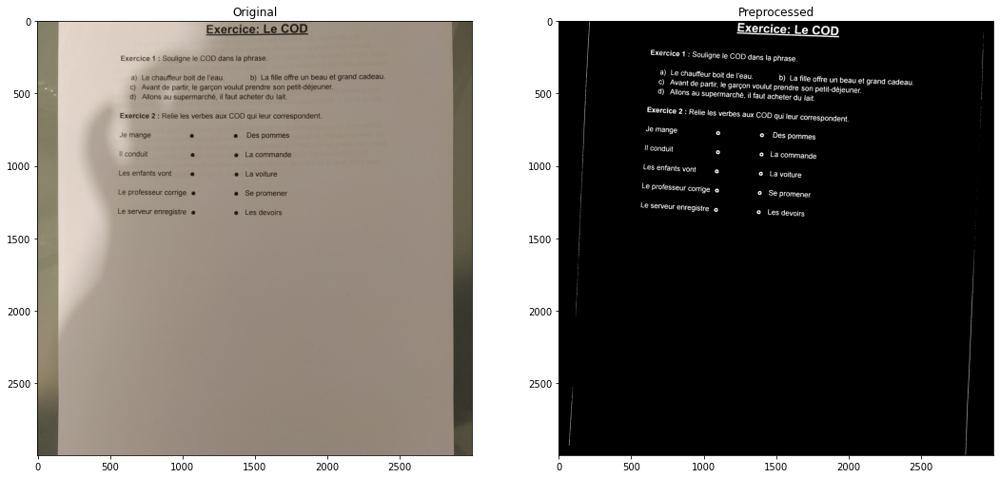

,Original,Preprocessed
0,eLes enfants vont @Le professeur corrige eLe serveur enregistre e: Le CODOD dans la phrase.Des pommese La commandee La voituree Se promenere Les devoirs,"——sExercice: Le CODExercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l'eau. b) La fille offre un beau et grand cadeau.C) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au Supermarché, il faut acheter du ETEExercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange O e Des pommesI! conduit L o La commandeLes enfants vont ° © La voitureLe professeur Corrige e © Se promenerLe serveur enregistre o o Les devoirs"




../Exemples/Ex_COD/IMG_20210329_122809.jpg
time preprocessed: 2.204s
time extract text from original: 4.232s
time extract text from preprocessed: 22.517s


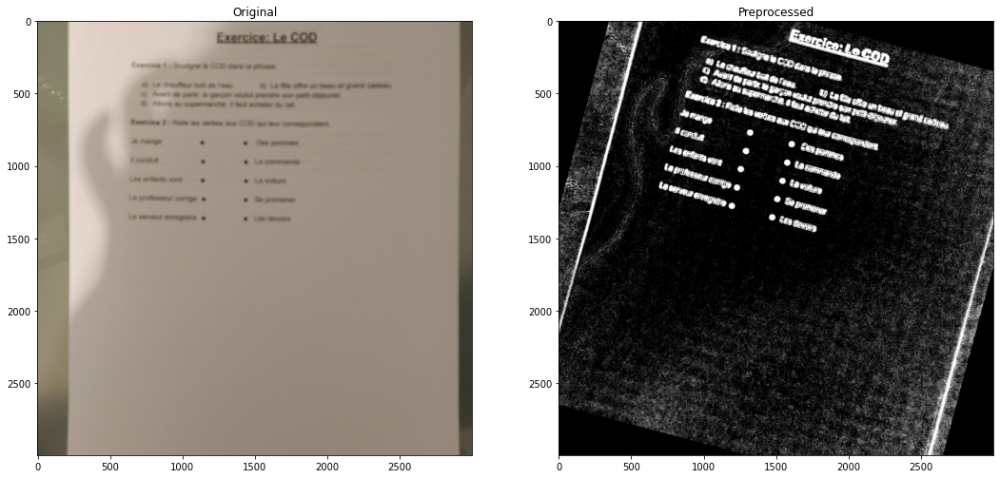

,Original,Preprocessed
0,,




../Exemples/Ex_COD/IMG_20210329_122251.jpg
time preprocessed: 1.152s
time extract text from original: 4.635s
time extract text from preprocessed: 1.225s


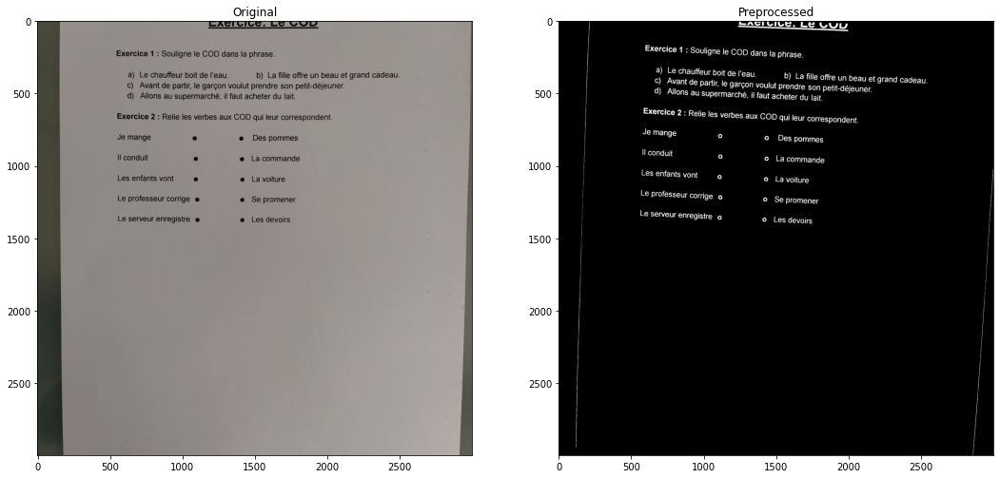

,Original,Preprocessed
0,"Exercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l'eau. b) La fille offre un beau et grand cadeau.c) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange e e Des pommesIl conduit ® e La commandeLes enfants vont ° e La voitureLe professeur corrige e e Se promenerLe serveur enregistre e e Les devoirs","PEN IN C. LE LULV\Exercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l'eau. b) La fille offre un beau et grand cadeau.C) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au Supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange e) o … Des pommesIl conduit e o La commandeLes enfants vont e) o La voitureLe professeur corrige o o Se promenerLe serveur enregistre o o Les devoirs"




../Exemples/Ex_COD/IMG_20210329_123624.jpg
time preprocessed: 1.144s
time extract text from original: 4.142s
time extract text from preprocessed: 1.444s


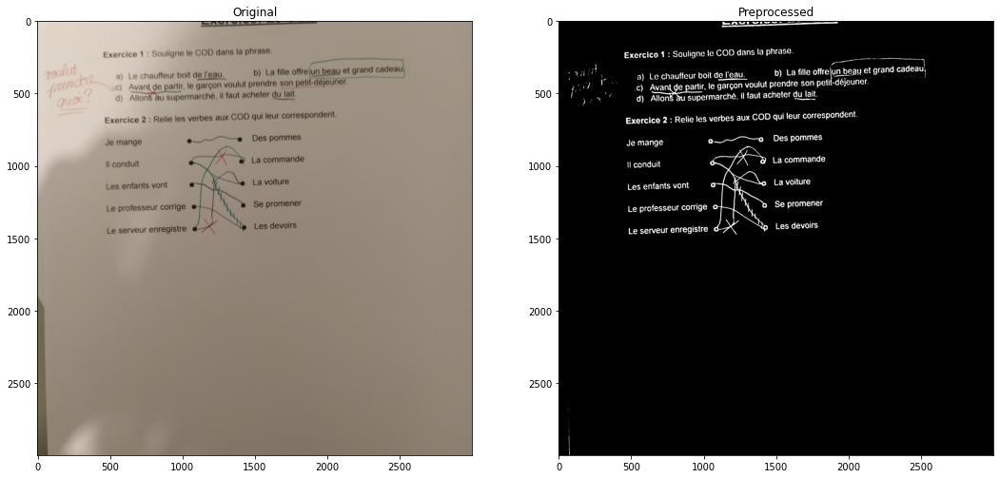

,Original,Preprocessed
0,Exercice 1 :a) Le chauffec) Avant,"rs qn rs ceExercico 4 : Souligne te COD dans la phrase.A 1a) Le chauffeur boit de l'eau. b) La fille oﬁre&un beau et grand cadzaeau=3,C) Avan% %e partir, le garçon voulut prendre son petit-déjeuner. ‘d) Allon supermarché, il faut acheter du lait. Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange o-————e Des pommesIl conduit ) La commandeLes enfants vont La voitureLe professeur corrige Se promenerLe serveur enregistre Les devoirs"




../Exemples/Ex_COD/IMG_20210329_122300.jpg
time preprocessed: 1.293s
time extract text from original: 4.569s
time extract text from preprocessed: 1.158s


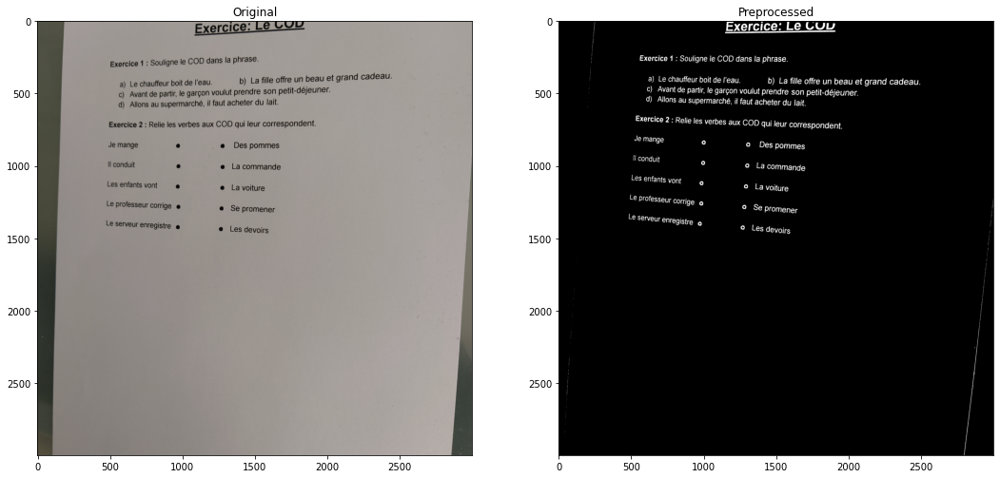

,Original,Preprocessed
0,"Exercice: Le VExercice 1 : Souligne le COD dans la phrase.eau.a) Le chauffeur boit de l'eau. b) La fille offre un beau et grand cadc) Avant de partir, le garçon voulut prendre sop petit-déjeuner.d) Allons au supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange © e Des pommesIl conduit e e La commandeLes enfants vont e e La voitureLe professeur corrige e e Se promenerLe serveur enregistre eLes devoirs","Exercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l’eau. b) La fille offre un beau et grand cadeau.c) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.o Des pommesJe mange Çe)Il conduit e) o La commandeLes enfants vont Le) o La voiture[e)Le professeur corrige o Se promenerLe serveur enregistre o o Les devoirs"




../Exemples/Ex_COD/IMG_20210329_123633.jpg
time preprocessed: 1.200s
time extract text from original: 4.290s
time extract text from preprocessed: 1.390s


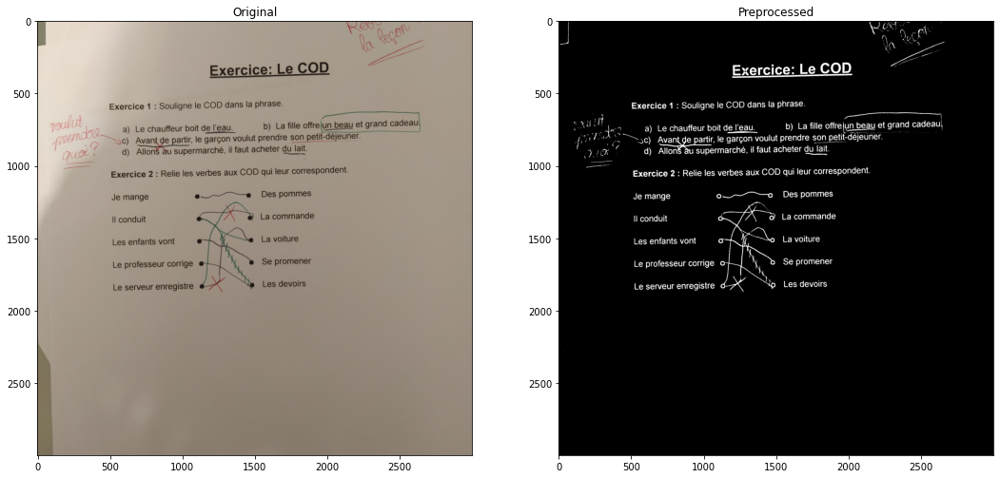

,Original,Preprocessed
0,,"._\ (\c C F Exercice: Le COD Exercice 1 : Souligne le COD dans la phrase.» vyil pL ; /{nQ a) Le chauffeur boit de l'eau. b) La fille oﬁretun el =r-10) et grand cadeauï/ p G SS e) Avanë %e partir, le garçon voulut prendre son pet it-déjeuner._ 7208 d) Allon supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange o-r——o Des pommesIl conduit | La commandeLes enfants vont La voitureLe professeur corrige Se promener Le serveur enregistre Les devoirs"




../Exemples/Ex_COD/IMG_20210329_122755.jpg
time preprocessed: 2.130s
time extract text from original: 4.481s
time extract text from preprocessed: 5.172s


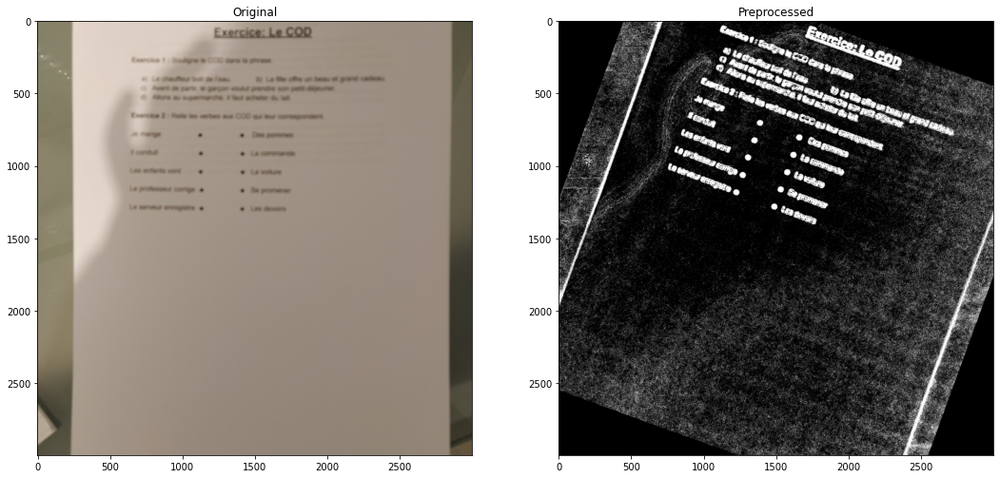

,Original,Preprocessed
0,"b 2 f 5 — …s S E —E 25 es dtoe 4 C S E RS A . - RE su rrrer en. . A C4- tis araurt “ - & suétia Edussas4 ts © 6 — rrrssé £â“““êﬂW""*l . - ts digoenis ct",




../Exemples/Ex_COD/IMG_20210329_122306.jpg
time preprocessed: 1.230s
time extract text from original: 4.907s
time extract text from preprocessed: 1.239s


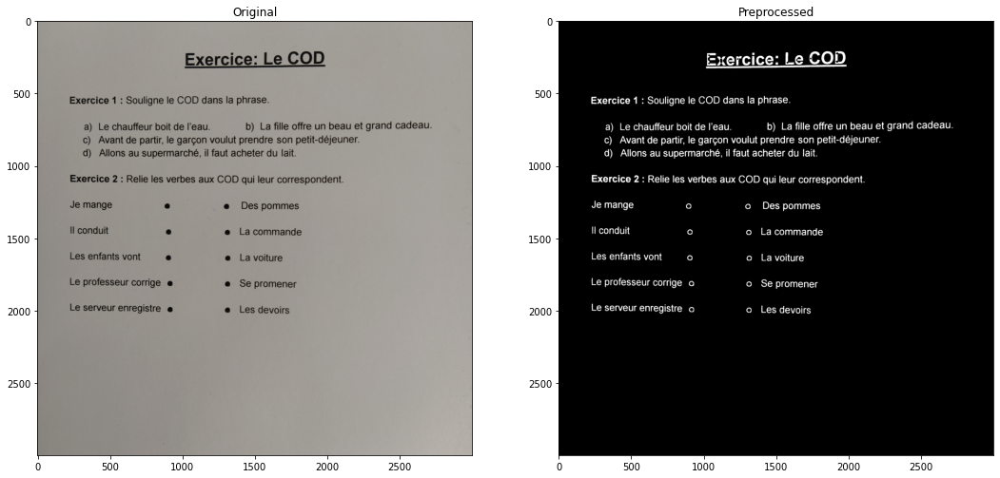

,Original,Preprocessed
0,"Exercice: Le COD Exercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l’eau. b) La fille offre un beau et grand cadeau.c) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange L e Des pommesIl conduit & e La commandeLes enfants vont 8 e La voitureLe professeur corrige e e Se promenerLe serveur enregistre e e Les devoirs","Exercice: Le COD Exercice 1 : Souligne le COD dans la phrase.a) Le chauffeur boit de l’eau. b) La fille offre un beau et grand cadeau.c) Avant de partir, le garçon voulut prendre son petit-déjeuner.d) Allons au supermarché, il faut acheter du lait.Exercice 2 : Relie les verbes aux COD qui leur correspondent.Je mange e o Des pommesIl conduit O o La commandeLes enfants vont e o La voitureLe professeur corrige o o Se promenerLe serveur enregistre o o Les devoirs"




../Exemples/Present_indicatif/IMG_20210329_122401.jpg
time preprocessed: 1.316s
time extract text from original: 5.034s
time extract text from preprocessed: 2.001s


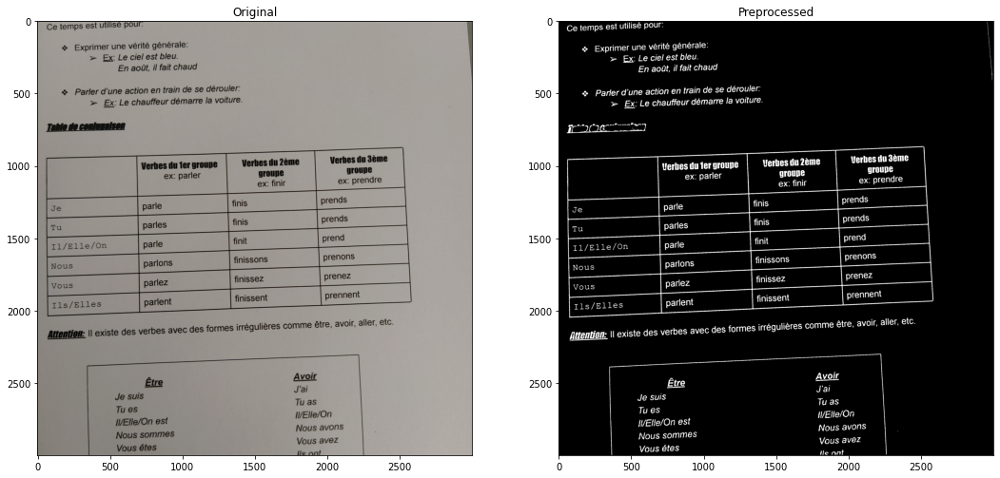

,Original,Preprocessed
0,"Ce temps est utilisé pour:& Exprimer une vérité générale:> Ex Le ciel est bleu.En août, il fait chaud * Parler d’une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture. Verhes du 1er groupe Verbes du 2ème Verhes du Sèmeex: parler groune groupeex: finir ex: prendregulières comme être, avoir, aller, etc.Attention: || existe des verbes avec des formes irré Être AvoirJe suis J'aiTu es Tu asIl/Elle/On est I/Elle/OnNous sommes Nous avonsVous êtes Vous avezlle nnt","Ce temps est utilisé pour:« Exprimer une vérité générale:> Ex: Le ciel est bleu.En août, il fait chaud« Parer d’une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture.msF —— Bms Verhes du 1er groune Verbes du 2ème Verhes du 3èmeex: parler groune groupeex: finir ex: prendreme être, avoir, aller, etc.des verbes avec des formes irrégulières comfttention: \ existe Être AvoirJe suIS J'aiTu es DENI/Elle/On est I/Elle/OnNous sommes Nous avonsVous êtes Vous avezle nnt"




../Exemples/Present_indicatif/IMG_20210329_122910.jpg
time preprocessed: 1.427s
time extract text from original: 4.610s
time extract text from preprocessed: 1.339s


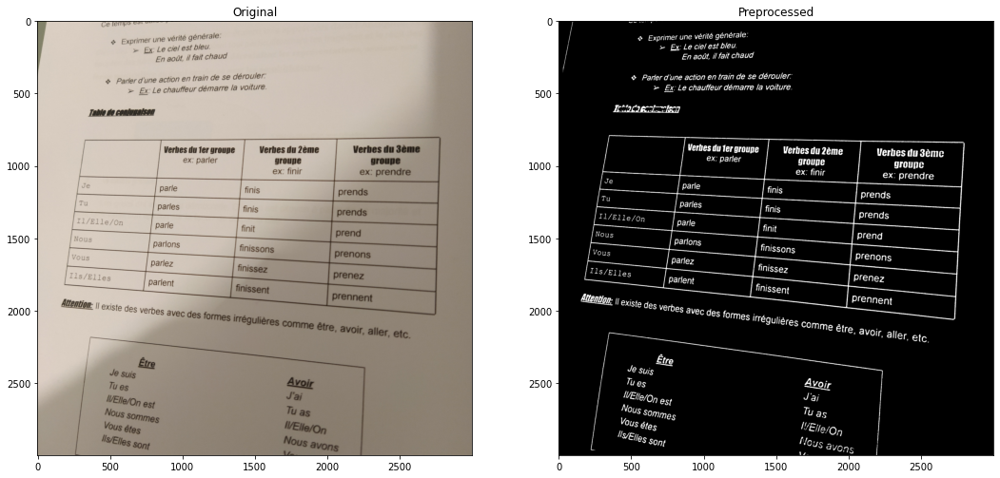

,Original,Preprocessed
0,"Çe temps e* - E« Exprimer une vérité générale:> Ex: Le ciel est bleu.En août, il fait chaud& Parler d'une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture.Attention: || existe des verbes av","L-& Exprimer une vérité générale:> Ex: Le ciel est bleu.En août, il fait chaud& Parler d'une action en train de se dérouler:> Ex. Le chauffeur démarre la voiture. Verhes u_u ler groune Verbes du 2ème Verbes du 3èmeex: parler groune grounpeex: finir ex: prendre"




../Exemples/Present_indicatif/IMG_20210329_122337.jpg
time preprocessed: 1.347s
time extract text from original: 5.031s
time extract text from preprocessed: 1.681s


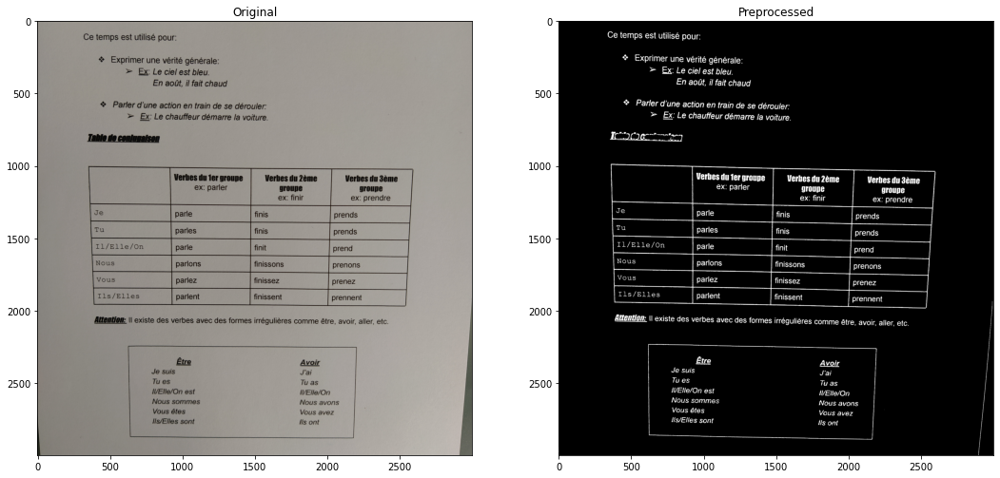

,Original,Preprocessed
0,"Ce temps est utilisé pour:* Exprimer une vérité générale:> Ex: Le ciel est bleu.En août, il fait chaud* Parler d’une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture. Verbes du 2ème Verbes du 3èmegroupe groupeex: finir ex: prendreAttention: \| existe des verbes avec des formes irrégulières comme être, avoir, aller, etc.Verbes du 1er groupeex: parler Être AvoirJe suis J'aiTu es Tu asIl/Elle/On est I/Elle/OnNous sommes Nous avonsVous êtes Vous avezlls/Elles sont Ils ont","Ce temps est utilisé pour:** Exprimer une vérité générale:> Ex Le ciel est bleu.En août, il fait chaud* Parler d’une action en train de se dérouler:> Ex Le chauffeur démarre la voiture.rr PHoa O mn Verbes du 1er grouneex: parlerVerhes du 2èmegroune groupeex: finir ex: prendreparles finisAttention: \\ existe des verbes avec des formes irégulières comme être, avoir, aller, etc.Verbes du 3ème JeTu Être V 170114 Je suis J'aiTues Tu asI/Elle/On est I/Elle/OnNous sommes Nous avonsVous étes Vous avez lis/Elles sont lls ont"




../Exemples/Present_indicatif/IMG_20210329_122915.jpg
time preprocessed: 1.411s
time extract text from original: 4.746s
time extract text from preprocessed: 1.126s


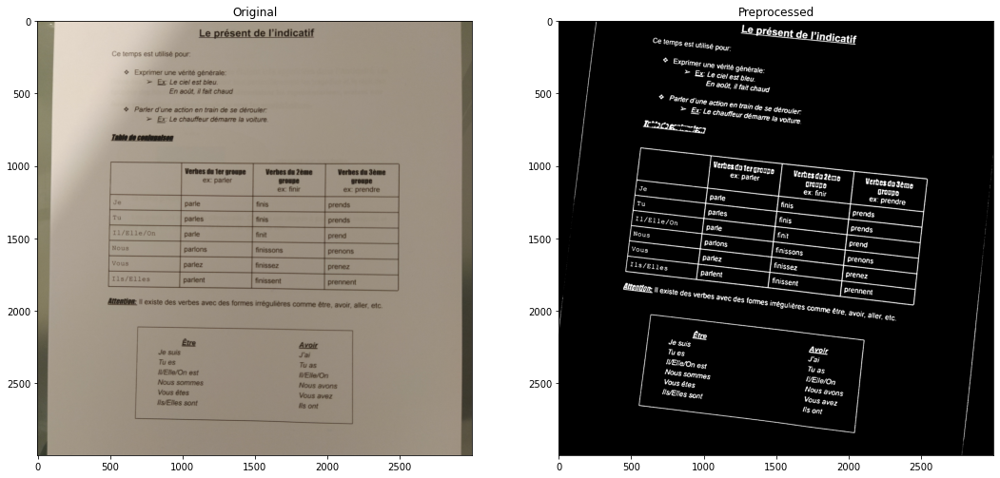

,Original,Preprocessed
0,"Le présent de l’indicatif>e temps est utilisé pour:— Exprimer une vérité générale:> Ex Le ciel est bleu.En août, il fait chaud* Parler d'une action en train de se dérouler-> Ex Le chauffeur démarre la voiture.","Le Présent [e [} l’indicatifCe lemps est Utilisé pour-:“ Exprimer Une vérité générale:- Le ciel est bleu,En août i fait chauge"




../Exemples/Present_indicatif/IMG_20210329_122904.jpg
time preprocessed: 1.393s
time extract text from original: 6.032s
time extract text from preprocessed: 1.523s


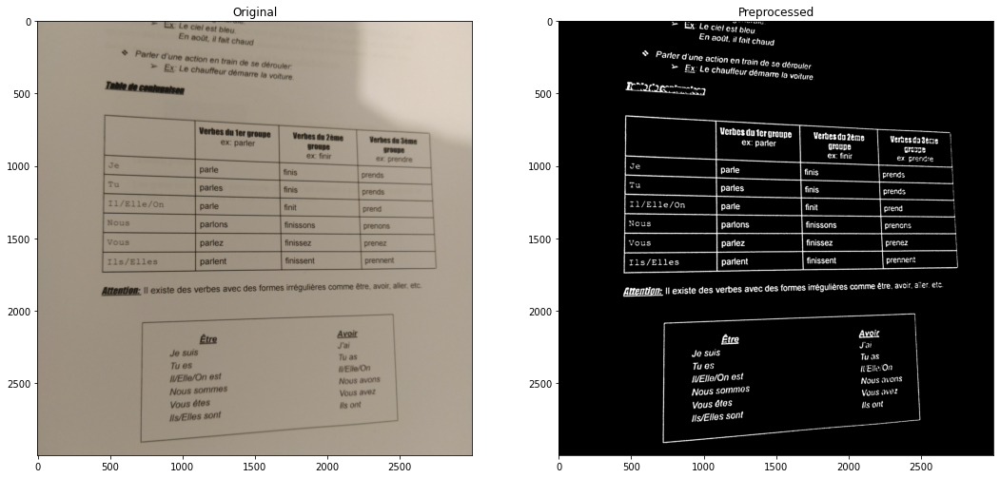

,Original,Preprocessed
0,"# Ex Lecie/ 0;:3::‘En août, il fait chaud» %a*… ection en> Ex Le chaufte—se —C0C0 e Nprous 7 pañom [encees [mnC *N CN EAttention: \| existe des verbes avec des formes irrégulières comme être, avoir, aller. etctrain de se œmub’ur démarre la voiturei du ferVerhes nex: parler Vertes du 3emeyrougeex. prendre Étre ||ai |Je suis sp ‘Tu es Wete |IVEHe/On es! Nous avons \Nous 80 R Vous avezVous êteslis/Elles sont MJ","423>77 ""1 CT> Ex Le ciel est bleu.En août, il fait chaug,Parler q une action €n frain de se dérouler-> Ex-le chauffeur démarre la voiture. Verbes du ter grouneex: parler Verties du 2ème Vertesda3èce Ïgroune@cisex: finirex: prendrerend 5__îM prennentIls/Elles M!Ë.____ __.£_.. g ‘ . d * LLi te S s c0 è }e p r ec ecnc Avoir J'atJe suis Tu as 0(vElie/OnTu es |J/Elie/On est Nous avonsNous sommesS Vous avezVOT ERELEESlls ont Iis/Eles sont"




../Exemples/Present_indicatif/IMG_20210329_122857.jpg
time preprocessed: 1.332s
time extract text from original: 4.437s
time extract text from preprocessed: 1.456s


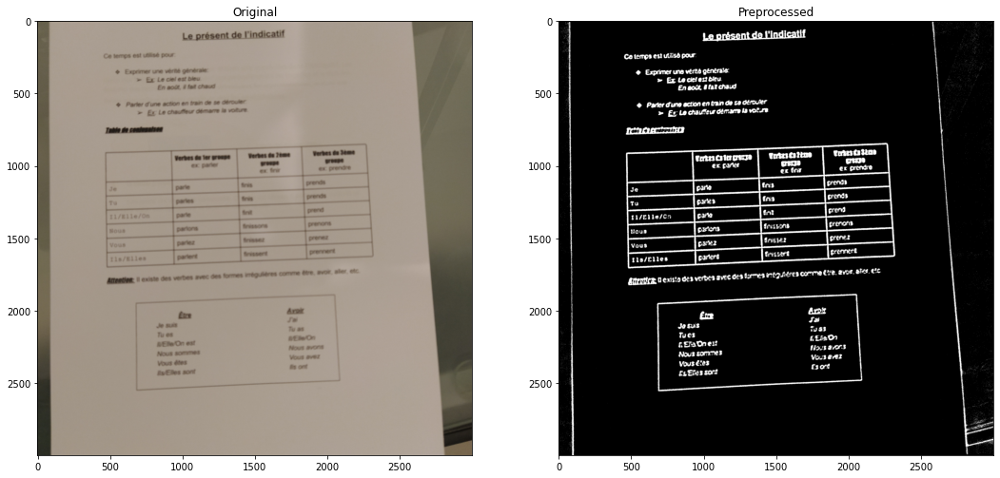

,Original,Preprocessed
0,Le présent de l’indicatifCe temps es! utiisé pour+ Exprimer une vérté gériéraie» Ex Le ciei est bieuEn août. # tut chaus* Parter d'une action e train de se JD» Es Le chaufleur Sérnarre is vorure Tu »4féut pvc s07fs r,"Ce terps est utilisé pour.® Exprimer une vérté géntrais-» Ex LociliertbleuEn coit, #fstchau9© Parier d'une ection en train de za CÉDeT> Er Le chauteur Gémaere la vol.rs Attentieme 0 existo des verbes aves Ges tsrres r 9.héres corvre Orre, avos. bs ec&xPejuëssfiss es3vVous erez£3s ort"




../Exemples/Present_indicatif/IMG_20210329_122406.jpg
time preprocessed: 1.310s
time extract text from original: 5.162s
time extract text from preprocessed: 1.501s


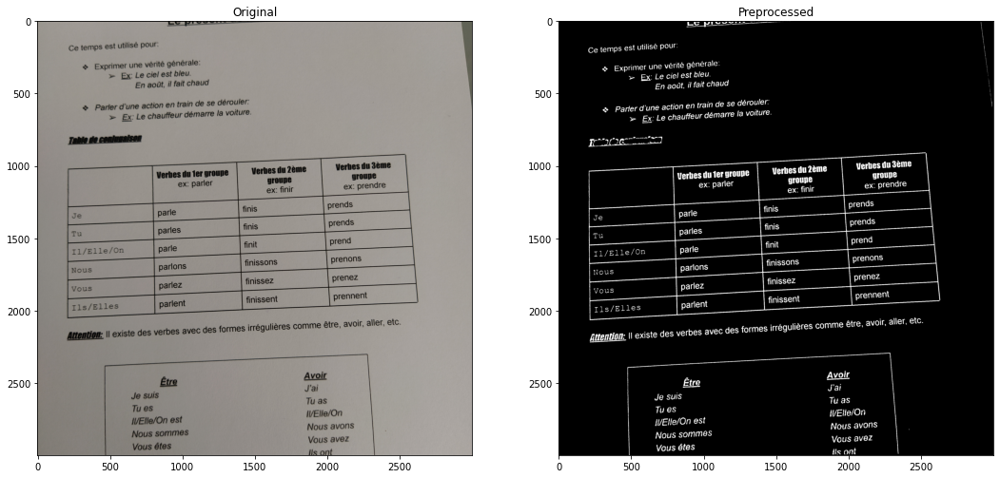

,Original,Preprocessed
0,"L EIÜÛV‘Igu P e psCe temps est utilisé pour:& Exprimer une vérité générale:> Ex Lecielest bleu.En août, il fait chaud« Parler d’une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture. Verhes du 3èmegroupe Verbes du 2èmegroupeex: finir Verbes du fer yrouneex: parlerprennentAttention: |i existe des verbes avec des formes irrégulières comme être, avoir, aller, etc. Étre AvoirJe suis J'aiTu es Tu asI/Elle/On est IvElle/OnNous sommes Nous avonsVous êtes Vous avezle nnf","Ce temps est utilisé pour:* Exprimer une vérité générale:> Ex Lecielest bleu.En août, il fait chaud« Parler d'une action en train de se dérouler:> Ex:Le chauffeur démarre la voiture. Verbes du 1er groupe Verbes du 2ème Verhes du 3èmeex: parier groune grouneex: finir ex: prendreprennentrmes irrégulières Comme être, avoir, aller, etc.fittention: \\ existe des verbes avec des fo Être AvoirJe suis J'aiTu es Tu asI/Elle/On est i/Elle/OnNous sommes Nous avonsVous êtes Vous avezils ont"




../Exemples/Present_indicatif/IMG_20210329_122343.jpg
time preprocessed: 1.270s
time extract text from original: 4.849s
time extract text from preprocessed: 1.392s


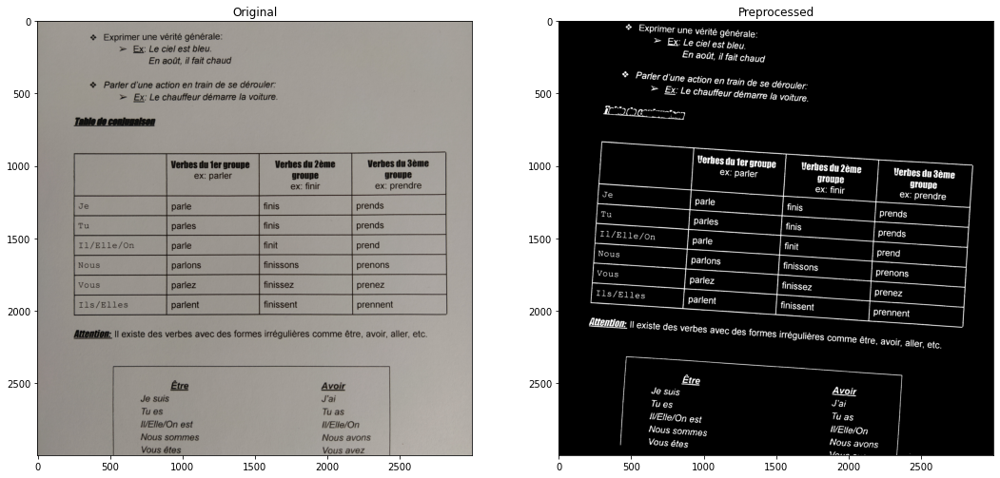

,Original,Preprocessed
0,"* Exprimer une vérité générale:> Ex: Le ciel est bleu.En août, il fait chaud* Parler d’une action en train de se dérouler:> Ex: Le chauffeur démarre la voiture. Verbes du 1er groupe Verbes du 2ème Verbes du 3èmeex: parler groupe groupeex: finir ex: prendre Table de conjugalsonAttention: || existe des verbes avec des formes irrégulières comme être, avoir, aller, etc. Être AvoirJe suis J'aiTu es Tu asIl/Elle/On est I/Elle/OnNous sommes Nous avonsVous êtes Vous avez","* Exprimer une vérité générale:> EX: Le ciel est bleu.En août, il fait chaud* Parlerd Uune action en train de se dérouler:> Ex Le chauffeur démarre la voiture..) SP S ATO Verbes du 1er groupe Verbes du 2ème Verbes du 3èmeex: parler groune groupeex: finir ex: prendre AvoirJe suis J'aiTues UMIETSWElle/On est IVElle/OnNous Sommes Nous avonsVous étes """


In [19]:
results = analyse_pipeline(all_files)

In [20]:
def time_mean(res, time_key):
    values = [v[time_key] for v in res.values()]
    
    return np.mean(values), np.std(values)

time_keys = {
    'loading': 'time_load',
    'preprocessing': 'time_preprocess',
    'extracting on original': 'time_res_original',
    'extracting on preprocessed': 'time_res_preprocess'
}

for time_str, time_key in time_keys.items():
    mean, std = time_mean(results, time_key)
    
    print('Time for %s: mean = %.1fs (std %.3fs)'%(time_str, mean, std))

Time for loading: mean = 0.3s (std 0.044s)
Time for preprocessing: mean = 1.4s (std 0.459s)
Time for extracting on original: mean = 4.6s (std 0.513s)
Time for extracting on preprocessed: mean = 2.1s (std 3.153s)
